In [1]:
import pandas as pd
import geopandas as gpd
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
import matplotlib.pyplot as plt 
%matplotlib inline
import re
from shapely.geometry import Point
from shapely.geometry import Polygon
pd.set_option('max_columns', 250)
import numpy

### Read Zillow All Home Median Value per Sq Ft data

In [2]:
zillow_data = pd.read_csv('Zip_MedianValuePerSqft_AllHomes.csv')
zillow_data

,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,1999-01,1999-02,1999-03,1999-04,1999-05,1999-06,1999-07,1999-08,1999-09,1999-10,1999-11,1999-12,2000-01,2000-02,2000-03,2000-04,2000-05,2000-06,2000-07,2000-08,2000-09,2000-10,2000-11,2000-12,2001-01,2001-02,2001-03,2001-04,2001-05,2001-06,2001-07,2001-08,2001-09,2001-10,2001-11,2001-12,2002-01,2002-02,2002-03,2002-04,2002-05,2002-06,2002-07,2002-08,2002-09,2002-10,2002-11,2002-12,2003-01,2003-02,2003-03,2003-04,2003-05,2003-06,2003-07,2003-08,2003-09,2003-10,2003-11,2003-12,2004-01,2004-02,2004-03,2004-04,2004-05,2004-06,2004-07,2004-08,2004-09,2004-10,2004-11,2004-12,2005-01,2005-02,2005-03,2005-04,2005-05,2005-06,2005-07,2005-08,2005-09,2005-10,2005-11,2005-12,2006-01,...,2007-01,2007-02,2007-03,2007-04,2007-05,2007-06,2007-07,2007-08,2007-09,2007-10,2007-11,2007-12,2008-01,2008-02,2008-03,2008-04,2008-05,2008-06,2008-07,2008-08,2008-09,2008-10,2008-11,2008-12,2009-01,2009-02,2009-03,2009-04,2009-05,2009-06,2009-07,2009-08,2009-09,2009-10,2009-11,2009-12,2010-01,2010-02,2010-03,2010-04,2010-05,2010-06,2010-07,2010-08,2010-09,2010-10,2010-11,2010-12,2011-01,2011-02,2011-03,2011-04,2011-05,2011-06,2011-07,2011-08,2011-09,2011-10,2011-11,2011-12,2012-01,2012-02,2012-03,2012-04,2012-05,2012-06,2012-07,2012-08,2012-09,2012-10,2012-11,2012-12,2013-01,2013-02,2013-03,2013-04,2013-05,2013-06,2013-07,2013-08,2013-09,2013-10,2013-11,2013-12,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05
0,61639,10025,New York,NY,New York,New York,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,555.0,592.0,628.0,660.0,690.0,720.0,746.0,758.0,754.0,744.0,737.0,735.0,734.0,729.0,731.0,742.0,749.0,754.0,771.0,794.0,815.0,830.0,...,903.0,884.0,877.0,864.0,847.0,833.0,831.0,838.0,846.0,850.0,853.0,854.0,857.0,864.0,871.0,879.0,895.0,908.0,914.0,919.0,918.0,912.0,906.0,902.0,900.0,892.0,876.0,860.0,845.0,833.0,821.0,812.0,807.0,805.0,804.0,811.0,824.0,833.0,840.0,846.0,854.0,859.0,862.0,867.0,876.0,886.0,896.0,900.0,897.0,894.0,891.0,888.0,883.0,877.0,870.0,868.0,869.0,870.0,871.0,870.0,869.0,876.0,890.0,904.0,921.0,938.0,952.0,958.0,957.0,956.0,959.0,968.0,978.0,988.0,999.0,1010.0,1016.0,1022.0,1028.0,1036,1047,1058,1068,1077,1087,1097,1109,1123,1137,1147,1151,1147,1142,1147,1155,1158,1157,1157,1156,1153,1155,1164,1182,1207,1235,1252,1257,1265,1281,1299.0,1311.0,1311.0,1307.0,1315,1329,1336,1336,1332,1332,1325.0,1309,1296,1290,1290,1294
1,84654,60657,Chicago,IL,Chicago,Cook,2,134.0,134.0,133.0,133.0,134.0,133.0,133.0,133.0,133.0,133.0,134.0,135.0,137.0,137.0,138.0,139.0,139.0,140.0,143.0,145.0,146.0,148.0,150.0,151.0,152.0,153.0,154.0,156.0,158.0,160.0,161.0,163.0,166.0,168.0,170.0,171.0,172.0,174.0,176.0,177.0,178.0,180.0,182.0,185.0,187.0,188.0,190.0,192.0,194.0,197.0,199.0,203.0,206.0,208.0,209.0,211.0,213.0,214.0,215.0,217.0,219.0,222.0,223.0,224.0,225.0,227.0,230.0,231.0,232.0,233.0,234.0,235.0,236.0,236.0,236.0,237.0,238.0,240.0,241.0,243.0,245.0,247.0,249.0,251.0,253.0,256.0,259.0,261.0,261.0,260.0,259.0,258.0,256.0,255.0,256.0,257.0,259.0,261.0,262.0,263.0,264.0,265.0,267.0,269.0,271.0,273.0,275.0,275.0,276.0,276.0,276.0,277.

### Keep only New York data

In [3]:
zillow_data[zillow_data.RegionName > 10000].sort_values(by='RegionName')

,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,1999-01,1999-02,1999-03,1999-04,1999-05,1999-06,1999-07,1999-08,1999-09,1999-10,1999-11,1999-12,2000-01,2000-02,2000-03,2000-04,2000-05,2000-06,2000-07,2000-08,2000-09,2000-10,2000-11,2000-12,2001-01,2001-02,2001-03,2001-04,2001-05,2001-06,2001-07,2001-08,2001-09,2001-10,2001-11,2001-12,2002-01,2002-02,2002-03,2002-04,2002-05,2002-06,2002-07,2002-08,2002-09,2002-10,2002-11,2002-12,2003-01,2003-02,2003-03,2003-04,2003-05,2003-06,2003-07,2003-08,2003-09,2003-10,2003-11,2003-12,2004-01,2004-02,2004-03,2004-04,2004-05,2004-06,2004-07,2004-08,2004-09,2004-10,2004-11,2004-12,2005-01,2005-02,2005-03,2005-04,2005-05,2005-06,2005-07,2005-08,2005-09,2005-10,2005-11,2005-12,2006-01,...,2007-01,2007-02,2007-03,2007-04,2007-05,2007-06,2007-07,2007-08,2007-09,2007-10,2007-11,2007-12,2008-01,2008-02,2008-03,2008-04,2008-05,2008-06,2008-07,2008-08,2008-09,2008-10,2008-11,2008-12,2009-01,2009-02,2009-03,2009-04,2009-05,2009-06,2009-07,2009-08,2009-09,2009-10,2009-11,2009-12,2010-01,2010-02,2010-03,2010-04,2010-05,2010-06,2010-07,2010-08,2010-09,2010-10,2010-11,2010-12,2011-01,2011-02,2011-03,2011-04,2011-05,2011-06,2011-07,2011-08,2011-09,2011-10,2011-11,2011-12,2012-01,2012-02,2012-03,2012-04,2012-05,2012-06,2012-07,2012-08,2012-09,2012-10,2012-11,2012-12,2013-01,2013-02,2013-03,2013-04,2013-05,2013-06,2013-07,2013-08,2013-09,2013-10,2013-11,2013-12,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05
2147,61615,10001,New York,NY,New York,New York,2148,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,641.0,679.0,720.0,758.0,792.0,824.0,849.0,865.0,882.0,889.0,886.0,882.0,891.0,899.0,906.0,916.0,931.0,945.0,968.0,999.0,1031.0,1053.0,1068.0,...,1133.0,1123.0,1122.0,1123.0,1128.0,1138.0,1155.0,1167.0,1168.0,1169.0,1177.0,1191.0,1206.0,1222.0,1231.0,1235.0,1234.0,1230.0,1226.0,1225.0,1226.0,1225.0,1219.0,1208.0,1198.0,1192.0,1183.0,1163.0,1141.0,1119.0,1097.0,1081.0,1072.0,1065.0,1057.0,1045.0,1032.0,1027.0,1034.0,1043.0,1056.0,1069.0,1079.0,1083.0,1084.0,1082.0,1084.0,1090.0,1093.0,1090.0,1087.0,1087.0,1091.0,1093.0,1096.0,1104.0,1116.0,1128.0,1137.0,1144.0,1148.0,1149.0,1151.0,1159.0,1167.0,1176.0,1187.0,1197.0,1203.0,1209.0,1215.0,1226.0,1240.0,1259.0,1284.0,1307.0,1321.0,1336.0,1352.0,1370,1392,1414,1436,1465,1500,1522,1531,1540,1548,1547,1540,1534,1535,1542,1552,1553,1551,1551,1553,1561,1583,1613,1643,1663,1673,1674,1672,1669,1673,1686.0,1696.0,1695.0,1696.0,1703,1710,1718,1719,1716,1720,1716.0,1705,1697,1693,1687,1685
5,61616,10002,New York,NY,New York,New York,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,726.0,722.0,713.0,714.0,723.0,736.0,755.0,779.0,804.0,819.0,827.0,...,947.0,942.0,942.0,945.0,950.0,958.0,972.0,981.0,980.0,976.0,979.0,981.0,987.0,99

In [4]:
zillow_newyork = zillow_data[zillow_data.City == 'New York']
zillow_newyork.sort_values(by='RegionName', inplace=True)
#zillow_newyork = zillow_newyork[zillow_newyork.State == 'NY']
zillow_newyork

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,1999-01,1999-02,1999-03,1999-04,1999-05,1999-06,1999-07,1999-08,1999-09,1999-10,1999-11,1999-12,2000-01,2000-02,2000-03,2000-04,2000-05,2000-06,2000-07,2000-08,2000-09,2000-10,2000-11,2000-12,2001-01,2001-02,2001-03,2001-04,2001-05,2001-06,2001-07,2001-08,2001-09,2001-10,2001-11,2001-12,2002-01,2002-02,2002-03,2002-04,2002-05,2002-06,2002-07,2002-08,2002-09,2002-10,2002-11,2002-12,2003-01,2003-02,2003-03,2003-04,2003-05,2003-06,2003-07,2003-08,2003-09,2003-10,2003-11,2003-12,2004-01,2004-02,2004-03,2004-04,2004-05,2004-06,2004-07,2004-08,2004-09,2004-10,2004-11,2004-12,2005-01,2005-02,2005-03,2005-04,2005-05,2005-06,2005-07,2005-08,2005-09,2005-10,2005-11,2005-12,2006-01,...,2007-01,2007-02,2007-03,2007-04,2007-05,2007-06,2007-07,2007-08,2007-09,2007-10,2007-11,2007-12,2008-01,2008-02,2008-03,2008-04,2008-05,2008-06,2008-07,2008-08,2008-09,2008-10,2008-11,2008-12,2009-01,2009-02,2009-03,2009-04,2009-05,2009-06,2009-07,2009-08,2009-09,2009-10,2009-11,2009-12,2010-01,2010-02,2010-03,2010-04,2010-05,2010-06,2010-07,2010-08,2010-09,2010-10,2010-11,2010-12,2011-01,2011-02,2011-03,2011-04,2011-05,2011-06,2011-07,2011-08,2011-09,2011-10,2011-11,2011-12,2012-01,2012-02,2012-03,2012-04,2012-05,2012-06,2012-07,2012-08,2012-09,2012-10,2012-11,2012-12,2013-01,2013-02,2013-03,2013-04,2013-05,2013-06,2013-07,2013-08,2013-09,2013-10,2013-11,2013-12,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05
2147,61615,10001,New York,NY,New York,New York,2148,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,641.0,679.0,720.0,758.0,792.0,824.0,849.0,865.0,882.0,889.0,886.0,882.0,891.0,899.0,906.0,916.0,931.0,945.0,968.0,999.0,1031.0,1053.0,1068.0,...,1133.0,1123.0,1122.0,1123.0,1128.0,1138.0,1155.0,1167.0,1168.0,1169.0,1177.0,1191.0,1206.0,1222.0,1231.0,1235.0,1234.0,1230.0,1226.0,1225.0,1226.0,1225.0,1219.0,1208.0,1198.0,1192.0,1183.0,1163.0,1141.0,1119.0,1097.0,1081.0,1072.0,1065.0,1057.0,1045.0,1032.0,1027.0,1034.0,1043.0,1056.0,1069.0,1079.0,1083.0,1084.0,1082.0,1084.0,1090.0,1093.0,1090.0,1087.0,1087.0,1091.0,1093.0,1096.0,1104.0,1116.0,1128.0,1137.0,1144.0,1148.0,1149.0,1151.0,1159.0,1167.0,1176.0,1187.0,1197.0,1203.0,1209.0,1215.0,1226.0,1240.0,1259.0,1284.0,1307.0,1321.0,1336.0,1352.0,1370,1392,1414,1436,1465,1500,1522,1531,1540,1548,1547,1540,1534,1535,1542,1552,1553,1551,1551,1553,1561,1583,1613,1643,1663,1673,1674,1672,1669,1673,1686.0,1696.0,1695.0,1696.0,1703,1710,1718,1719,1716,1720,1716.0,1705,1697,1693,1687,1685
5,61616,10002,New York,NY,New York,New York,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,726.0,722.0,713.0,714.0,723.0,736.0,755.0,779.0,804.0,819.0,827.0,...,947.0,942.0,942.0,945.0,950.0,958.0,972.0,981.0,980.0,976.0,979.0,981.0,987.0,99

In [5]:
zillow_newyork.RegionName.dtype

dtype('int64')

In [6]:
zillow_newyork.RegionName = zillow_newyork.RegionName.astype(str)
zillow_newyork.RegionName.dtype

/usr/local/lib/python3.6/site-packages/pandas/core/generic.py:3110: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value


dtype('O')

### Read NYC ZIP Codes shapefiles

In [7]:
zip_codes = gpd.read_file('ZIP_CODE_040114/ZIP_CODE_040114.shp')
zip_codes.head(8)

,AREA,BLDGZIP,COUNTY,CTY_FIPS,POPULATION,PO_NAME,SHAPE_AREA,SHAPE_LEN,STATE,ST_FIPS,URL,ZIPCODE,geometry
0,2.269930e+07,0,Queens,081,18681.0,Jamaica,0.0,0.0,NY,36,http://www.usps.com/,11436,"POLYGON ((1038098.251871482 188138.3800067157,..."
1,2.963100e+07,0,Kings,047,62426.0,Brooklyn,0.0,0.0,NY,36,http://www.usps.com/,11213,"POLYGON ((1001613.712964058 186926.4395172149,..."
2,4.197210e+07,0,Kings,047,83866.0,Brooklyn,0.0,0.0,NY,36,http://www.usps.com/,11212,"POLYGON ((1011174.275535807 183696.33770971, 1..."
3,2.369863e+07,0,Kings,047,56527.0,Brooklyn,0.0,0.0,NY,36,http://www.usps.com/,11225,"POLYGON ((995908.3654508889 183617.6128015518,..."
4,3.686880e+07,0,Kings,047,72280.0,Brooklyn,0.0,0.0,NY,36,http://www.usps.com/,11218,"POLYGON ((991997.1134308875 176307.4958601296,..."
5,3.940860e+07,0,Kings,047,106132.0,Brooklyn,0.0,0.0,NY,36,http://www.usps.com/,11226,"POLYGON ((994821.4729396403 177865.7178093046,..."
6,4.200274e+07,0,Kings,047,92561.0,Brooklyn,0.0,0.0,NY,36,http://www.usps.com/,11219,"POLYGON ((987286.3515269756 173946.4621963799,..."
7,4.788702e+07,0,Kings,047,67067.0,Brooklyn,0.0,0.0,NY,36,http://www.usps.com/,11210,"POLYGON ((995796.0097044706 171110.0666224658,..."


In [8]:
zip_codes.crs

{'datum': 'NAD83',
 'lat_0': 40.16666666666666,
 'lat_1': 40.66666666666666,
 'lat_2': 41.03333333333333,
 'lon_0': -74,
 'no_defs': True,
 'proj': 'lcc',
 'units': 'us-ft',
 'x_0': 300000,
 'y_0': 0}

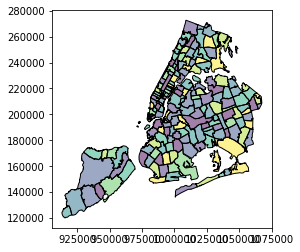

In [9]:
zip_codes.plot()

In [10]:
zip_codes = zip_codes.to_crs(epsg=4269)
zip_codes.crs

{'init': 'epsg:4269', 'no_defs': True}

In [11]:
zip_codes.sort_values(by='ZIPCODE', inplace=True)
zip_codes

,AREA,BLDGZIP,COUNTY,CTY_FIPS,POPULATION,PO_NAME,SHAPE_AREA,SHAPE_LEN,STATE,ST_FIPS,URL,ZIPCODE,geometry
54,3.830099e+07,0,New York,061,25.0,Central Park,0.0,0.0,NY,36,http://www.usps.com/,00083,POLYGON ((-73.94922045723267 40.79690954939698...
82,1.779494e+07,0,New York,061,22413.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10001,POLYGON ((-74.00827017706987 40.75258680959694...
92,2.628013e+07,0,New York,061,81305.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10002,POLYGON ((-73.97441674502171 40.73642408546696...
90,1.553838e+07,0,New York,061,55878.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10003,POLYGON ((-73.97986374206835 40.73497413255047...
113,7.679616e+06,0,New York,061,2187.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10004,POLYGON ((-74.02418462341043 40.68391843465154...
114,6.707080e+05,0,New York,061,2187.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10004,POLYGON ((-74.04699098889017 40.69012439173012...
109,1.202708e+06,0,New York,061,2187.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10004,"POLYGON ((-74.0416636832214 40.696449537742, -..."
106,4.002521e+06,0,New York,061,2187.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10004,POLYGON ((-74.01101005119982 40.70621840523224...
104,2.082901e+06,0,New York,061,8107.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10005,POLYGON ((-74.00596661457033 40.70432398933988...
102,1.716641e+06,0,New York,061,3011.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10006,POLYGON ((-74.01123100039382 40.71036655056447...


### Merge with New York Zillow data
129 rows originally, 128 after merge

In [12]:
zillow_newyork_zips = zillow_newyork.merge(zip_codes, left_on='RegionName', right_on='ZIPCODE')
zillow_newyork_zips.sort_values(by='RegionName', inplace=True)
zillow_newyork_zips

,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,1999-01,1999-02,1999-03,1999-04,1999-05,1999-06,1999-07,1999-08,1999-09,1999-10,1999-11,1999-12,2000-01,2000-02,2000-03,2000-04,2000-05,2000-06,2000-07,2000-08,2000-09,2000-10,2000-11,2000-12,2001-01,2001-02,2001-03,2001-04,2001-05,2001-06,2001-07,2001-08,2001-09,2001-10,2001-11,2001-12,2002-01,2002-02,2002-03,2002-04,2002-05,2002-06,2002-07,2002-08,2002-09,2002-10,2002-11,2002-12,2003-01,2003-02,2003-03,2003-04,2003-05,2003-06,2003-07,2003-08,2003-09,2003-10,2003-11,2003-12,2004-01,2004-02,2004-03,2004-04,2004-05,2004-06,2004-07,2004-08,2004-09,2004-10,2004-11,2004-12,2005-01,2005-02,2005-03,2005-04,2005-05,2005-06,2005-07,2005-08,2005-09,2005-10,2005-11,2005-12,2006-01,...,2008-02,2008-03,2008-04,2008-05,2008-06,2008-07,2008-08,2008-09,2008-10,2008-11,2008-12,2009-01,2009-02,2009-03,2009-04,2009-05,2009-06,2009-07,2009-08,2009-09,2009-10,2009-11,2009-12,2010-01,2010-02,2010-03,2010-04,2010-05,2010-06,2010-07,2010-08,2010-09,2010-10,2010-11,2010-12,2011-01,2011-02,2011-03,2011-04,2011-05,2011-06,2011-07,2011-08,2011-09,2011-10,2011-11,2011-12,2012-01,2012-02,2012-03,2012-04,2012-05,2012-06,2012-07,2012-08,2012-09,2012-10,2012-11,2012-12,2013-01,2013-02,2013-03,2013-04,2013-05,2013-06,2013-07,2013-08,2013-09,2013-10,2013-11,2013-12,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,AREA,BLDGZIP,COUNTY,CTY_FIPS,POPULATION,PO_NAME,SHAPE_AREA,SHAPE_LEN,STATE,ST_FIPS,URL,ZIPCODE,geometry
0,61615,10001,New York,NY,New York,New York,2148,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,641.0,679.0,720.0,758.0,792.0,824.0,849.0,865.0,882.0,889.0,886.0,882.0,891.0,899.0,906.0,916.0,931.0,945.0,968.0,999.0,1031.0,1053.0,1068.0,...,1222.0,1231.0,1235.0,1234.0,1230.0,1226.0,1225.0,1226.0,1225.0,1219.0,1208.0,1198.0,1192.0,1183.0,1163.0,1141.0,1119.0,1097.0,1081.0,1072.0,1065.0,1057.0,1045.0,1032.0,1027.0,1034.0,1043.0,1056.0,1069.0,1079.0,1083.0,1084.0,1082.0,1084.0,1090.0,1093.0,1090.0,1087.0,1087.0,1091.0,1093.0,1096.0,1104.0,1116.0,1128.0,1137.0,1144.0,1148.0,1149.0,1151.0,1159.0,1167.0,1176.0,1187.0,1197.0,1203.0,1209.0,1215.0,1226.0,1240.0,1259.0,1284.0,1307.0,1321.0,1336.0,1352.0,1370,1392,1414,1436,1465,1500,1522,1531,1540,1548,1547,1540,1534,1535,1542,1552,1553,1551,1551,1553,1561,1583,1613,1643,1663,1673,1674,1672,1669,1673,1686.0,1696.0,1695.0,1696.0,1703,1710,1718,1719,1716,1720,1716.0,1705,1697,1693,1687,1685,1.779494e+07,0,New York,061,22413.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10001,POLYGON ((-74.00827017706987 40.75258680959694...
1,61616,10002,New York,NY,New York,New York,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,726.0,722.0,713.0,714.0,723.0,736.0,755.0,779.0,804.0,819.0,827.0,...,997.0,1010.0,1020.0,1028.0,1030.0,1022

In [13]:
zillow_newyork_zips = gpd.GeoDataFrame(zillow_newyork_zips)
zillow_newyork_zips.crs = {'init': 'epsg:4269'}
zillow_newyork_zips.crs

{'init': 'epsg:4269'}

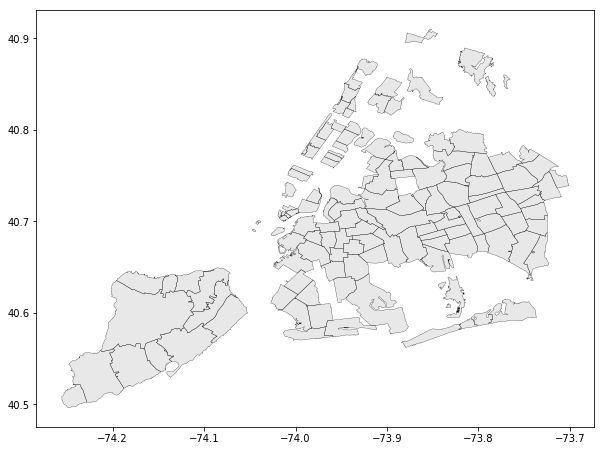

In [14]:
zillow_newyork_zips.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.25)

### Read Manhattanville Campus geometries

In [15]:
campus = gpd.read_file('Polygons GeoJSON.json')
campus

,building,geometry
0,Jerome L. Greene Science Center,"POLYGON ((-73.95857155323 40.816689733063, -73..."
1,University Forum and Academic Conference Center,"POLYGON ((-73.958373069763 40.816009710278, -7..."
2,560 Riverside,"POLYGON ((-73.959885835648 40.816610566589, -7..."
3,Columbia Business School,"POLYGON ((-73.958276510239 40.81804975772, -73..."
4,Lenfest Center for the Arts,"POLYGON ((-73.95877 40.817438, -73.959006 40.8..."
5,Studebaker,"POLYGON ((-73.958303 40.818222, -73.957949 40...."
6,Prentis Hall,"POLYGON ((-73.959958255291 40.816565908537, -7..."
7,Nash,"POLYGON ((-73.955838382244 40.818630297068, -7..."
8,West Harlem Piers Park,"POLYGON ((-73.959767818451 40.820296782144, -7..."


In [16]:
campus.crs = {'init': 'epsg:4269'}
campus.crs

{'init': 'epsg:4269'}

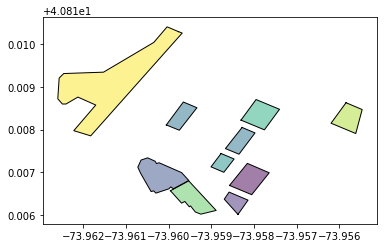

In [17]:
campus.plot()

### Plot Campus on top of ZIPs

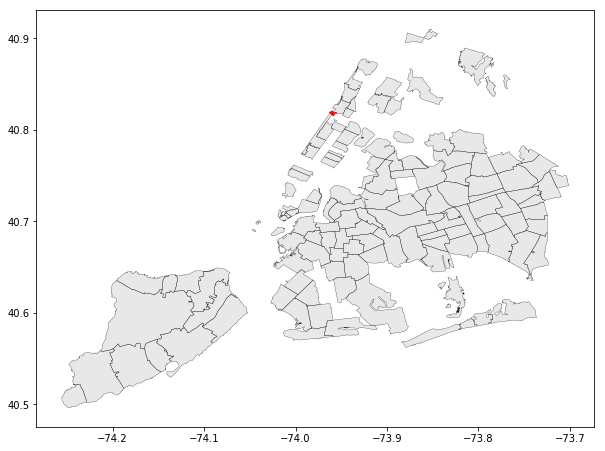

In [18]:
ax = zillow_newyork_zips.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.25)
campus.plot(color='red', ax=ax, edgecolor='red')

### Campus Unary Union

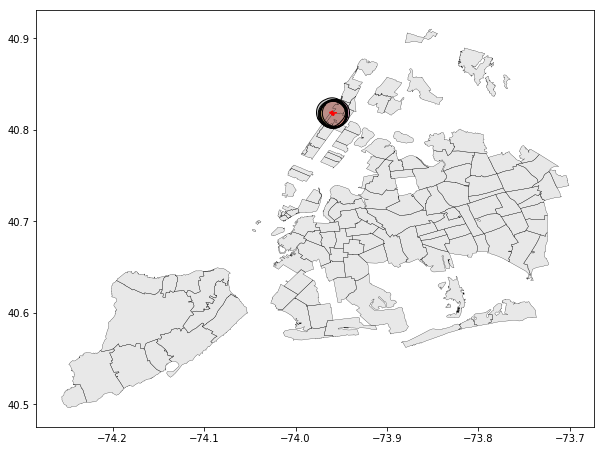

In [19]:
ax = zillow_newyork_zips.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.25)
campus.plot(color='red', ax=ax, edgecolor='red')
campus.buffer(0.01449275362).plot(ax=ax)#.unary_union

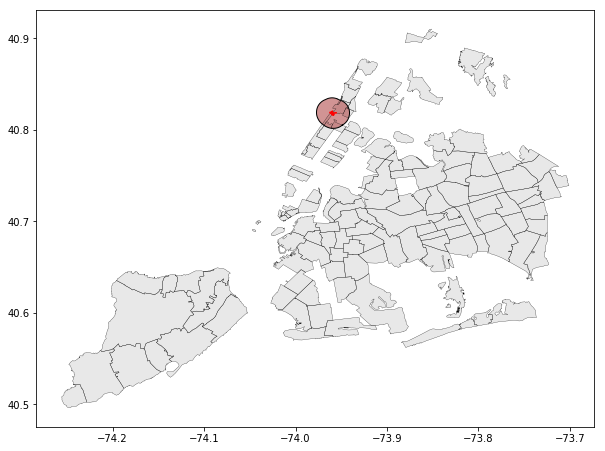

In [20]:
ax = zillow_newyork_zips.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.25)
campus.plot(color='red', ax=ax, edgecolor='red')
campus_buffer = campus.buffer(0.01449275362).unary_union
gpd.plotting.plot_multipolygon(ax=ax, geom=campus_buffer, facecolor='brown')

[-74, -73.9, 40.7, 40.9]

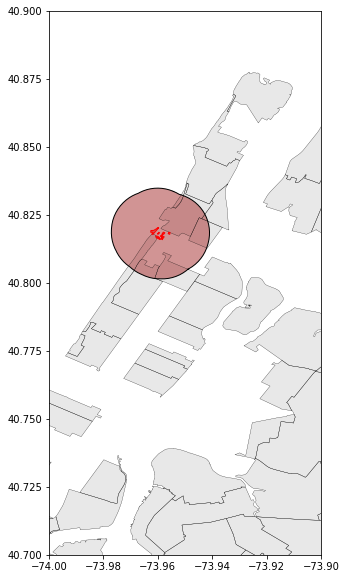

In [21]:
ax = zillow_newyork_zips.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.25)
campus.plot(color='red', ax=ax, edgecolor='red')
campus_buffer = campus.buffer(0.01449275362).unary_union
gpd.plotting.plot_multipolygon(ax=ax, geom=campus_buffer, facecolor='brown')
ax.axis([-74,-73.9,40.7,40.9])

### ZIPs that intersect with Campus' unary union

In [22]:
zips_campus_unary = zillow_newyork_zips[zillow_newyork_zips.intersects(campus.buffer(0.01449275362).unary_union)]
zips_campus_unary

,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,1999-01,1999-02,1999-03,1999-04,1999-05,1999-06,1999-07,1999-08,1999-09,1999-10,1999-11,1999-12,2000-01,2000-02,2000-03,2000-04,2000-05,2000-06,2000-07,2000-08,2000-09,2000-10,2000-11,2000-12,2001-01,2001-02,2001-03,2001-04,2001-05,2001-06,2001-07,2001-08,2001-09,2001-10,2001-11,2001-12,2002-01,2002-02,2002-03,2002-04,2002-05,2002-06,2002-07,2002-08,2002-09,2002-10,2002-11,2002-12,2003-01,2003-02,2003-03,2003-04,2003-05,2003-06,2003-07,2003-08,2003-09,2003-10,2003-11,2003-12,2004-01,2004-02,2004-03,2004-04,2004-05,2004-06,2004-07,2004-08,2004-09,2004-10,2004-11,2004-12,2005-01,2005-02,2005-03,2005-04,2005-05,2005-06,2005-07,2005-08,2005-09,2005-10,2005-11,2005-12,2006-01,...,2008-02,2008-03,2008-04,2008-05,2008-06,2008-07,2008-08,2008-09,2008-10,2008-11,2008-12,2009-01,2009-02,2009-03,2009-04,2009-05,2009-06,2009-07,2009-08,2009-09,2009-10,2009-11,2009-12,2010-01,2010-02,2010-03,2010-04,2010-05,2010-06,2010-07,2010-08,2010-09,2010-10,2010-11,2010-12,2011-01,2011-02,2011-03,2011-04,2011-05,2011-06,2011-07,2011-08,2011-09,2011-10,2011-11,2011-12,2012-01,2012-02,2012-03,2012-04,2012-05,2012-06,2012-07,2012-08,2012-09,2012-10,2012-11,2012-12,2013-01,2013-02,2013-03,2013-04,2013-05,2013-06,2013-07,2013-08,2013-09,2013-10,2013-11,2013-12,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,AREA,BLDGZIP,COUNTY,CTY_FIPS,POPULATION,PO_NAME,SHAPE_AREA,SHAPE_LEN,STATE,ST_FIPS,URL,ZIPCODE,geometry
14,61638,10024,New York,NY,New York,New York,47,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,918.0,939.0,951.0,950.0,943.0,936.0,928.0,922.0,919.0,921.0,927.0,942.0,963.0,984.0,1001.0,1022.0,...,1185.0,1189.0,1193.0,1201.0,1205.0,1201.0,1192.0,1180.0,1168.0,1153.0,1139.0,1128.0,1112.0,1089.0,1066.0,1039.0,1008.0,983.0,970.0,967.0,967.0,965.0,965.0,967.0,970.0,979.0,987.0,995.0,1001.0,1006.0,1011.0,1019.0,1026.0,1027.0,1025.0,1027.0,1035.0,1040.0,1043.0,1044.0,1048.0,1054.0,1055.0,1052.0,1052.0,1053.0,1053.0,1055.0,1062.0,1069.0,1074.0,1079.0,1087.0,1098.0,1110.0,1118.0,1123.0,1128.0,1136.0,1144.0,1148.0,1156.0,1169.0,1178.0,1182.0,1186.0,1195,1208,1222,1233,1242,1254,1266,1276,1289,1305,1319,1321,1315,1311,1314,1317,1316,1312,1313,1315,1317,1325,1340,1358,1376,1394,1405,1406,1408,1418,1435.0,1443.0,1442.0,1444.0,1458,1477,1494,1499,1492,1488,1488.0,1485,1476,1468,1471,1480,2.287734e+07,0,New York,061,58521.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10024,POLYGON ((-73.96401951406308 40.81133035983067...
15,61639,10025,New York,NY,New York,New York,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,555.0,592.0,628.0,660.0,690.0,720.0,746.0,758.0,754.0,744.0,737.0,735.0,734.0,729.0,731.0,742.0,749.0,754.0,771.0,794.0,815.0,830.0,...,864.0,871.0,879.0,895.0,908.0,914.0,919.0,

[-74, -73.9, 40.7, 40.9]

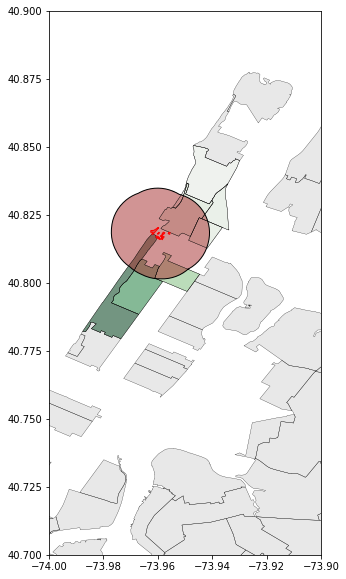

In [23]:
ax = zillow_newyork_zips.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.25)
zips_campus_unary.plot(figsize=(10,10), column='2017-05', cmap='Greens', edgecolor='black', linewidth=0.25, ax=ax)
campus.plot(color='red', ax=ax, edgecolor='red')
campus_buffer = campus.buffer(0.01449275362).unary_union
gpd.plotting.plot_multipolygon(ax=ax, geom=campus_buffer, facecolor='brown')
ax.axis([-74,-73.9,40.7,40.9])

### Plot missing ZIPs (plot all NYC ZIPs) as first level

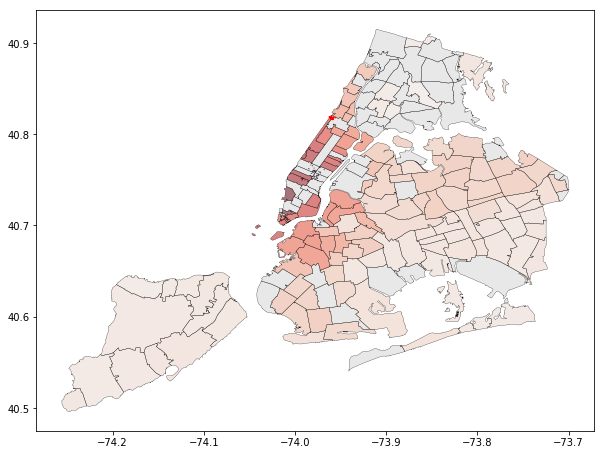

In [24]:
ax = zip_codes.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.25)
zillow_newyork_zips.plot(figsize=(10,10), cmap='Reds', column='2017-05', edgecolor='black', linewidth=0, ax=ax)
campus.plot(color='red', ax=ax, edgecolor='red')

### Campus centroid - buffer - unary

##### simple unary

[-74, -73.9, 40.7, 40.9]

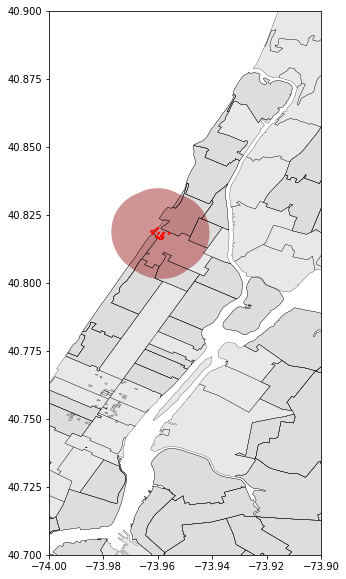

In [25]:
ax = zip_codes.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.25)
zillow_newyork_zips.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.25, ax=ax)
campus.plot(color='red', ax=ax, edgecolor='red')
campus_buffer = campus.buffer(0.01449275362).unary_union
gpd.plotting.plot_multipolygon(ax=ax, geom=campus_buffer, facecolor='brown', edgecolor='brown', linewidth=0)
ax.axis([-74,-73.9,40.7,40.9])

#### Centroid

In [26]:
campus.centroid

0    POINT (-73.95810488197937 40.81683883115718)
1    POINT (-73.95842481480889 40.81629835817648)
2    POINT (-73.96019531045317 40.81691221341467)
3    POINT (-73.97940153768783 40.82660722991123)
4    POINT (-73.95873587312995 40.81721826939253)
5    POINT (-73.95785104264185 40.81834932135211)
6     POINT (-73.9594357102867 40.81638732935974)
7    POINT (-73.95578361041298 40.81827121926955)
8    POINT (-73.96132535774808 40.81911205260749)
dtype: object

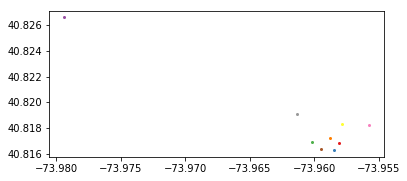

In [27]:
campus.centroid.plot()

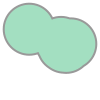

In [28]:
campus.centroid.buffer(0.01449275362).unary_union

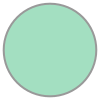

In [29]:
campus.buffer(0.01449275362).unary_union.centroid.buffer(0.01449275362)

[-74, -73.9, 40.7, 40.9]

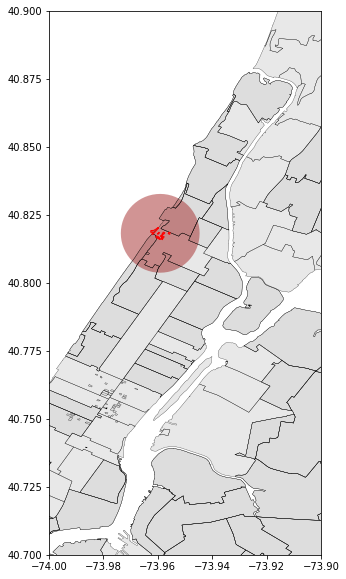

In [30]:
ax = zip_codes.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.25)
zillow_newyork_zips.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.25, ax=ax)
campus.plot(color='red', ax=ax, edgecolor='red')
campus_buffer = campus.buffer(0.01449275362).unary_union.centroid.buffer(0.01449275362)
gpd.plotting.plot_polygon(ax=ax, poly=campus_buffer, facecolor='brown', edgecolor='brown', linewidth=0)
ax.axis([-74,-73.9,40.7,40.9])

### Line plot of the ZIPs that intersect with campus buffer

In [31]:
zillow_newyork_zips[zillow_newyork_zips.intersects(campus_buffer)]

,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,1999-01,1999-02,1999-03,1999-04,1999-05,1999-06,1999-07,1999-08,1999-09,1999-10,1999-11,1999-12,2000-01,2000-02,2000-03,2000-04,2000-05,2000-06,2000-07,2000-08,2000-09,2000-10,2000-11,2000-12,2001-01,2001-02,2001-03,2001-04,2001-05,2001-06,2001-07,2001-08,2001-09,2001-10,2001-11,2001-12,2002-01,2002-02,2002-03,2002-04,2002-05,2002-06,2002-07,2002-08,2002-09,2002-10,2002-11,2002-12,2003-01,2003-02,2003-03,2003-04,2003-05,2003-06,2003-07,2003-08,2003-09,2003-10,2003-11,2003-12,2004-01,2004-02,2004-03,2004-04,2004-05,2004-06,2004-07,2004-08,2004-09,2004-10,2004-11,2004-12,2005-01,2005-02,2005-03,2005-04,2005-05,2005-06,2005-07,2005-08,2005-09,2005-10,2005-11,2005-12,2006-01,...,2008-02,2008-03,2008-04,2008-05,2008-06,2008-07,2008-08,2008-09,2008-10,2008-11,2008-12,2009-01,2009-02,2009-03,2009-04,2009-05,2009-06,2009-07,2009-08,2009-09,2009-10,2009-11,2009-12,2010-01,2010-02,2010-03,2010-04,2010-05,2010-06,2010-07,2010-08,2010-09,2010-10,2010-11,2010-12,2011-01,2011-02,2011-03,2011-04,2011-05,2011-06,2011-07,2011-08,2011-09,2011-10,2011-11,2011-12,2012-01,2012-02,2012-03,2012-04,2012-05,2012-06,2012-07,2012-08,2012-09,2012-10,2012-11,2012-12,2013-01,2013-02,2013-03,2013-04,2013-05,2013-06,2013-07,2013-08,2013-09,2013-10,2013-11,2013-12,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,AREA,BLDGZIP,COUNTY,CTY_FIPS,POPULATION,PO_NAME,SHAPE_AREA,SHAPE_LEN,STATE,ST_FIPS,URL,ZIPCODE,geometry
14,61638,10024,New York,NY,New York,New York,47,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,918.0,939.0,951.0,950.0,943.0,936.0,928.0,922.0,919.0,921.0,927.0,942.0,963.0,984.0,1001.0,1022.0,...,1185.0,1189.0,1193.0,1201.0,1205.0,1201.0,1192.0,1180.0,1168.0,1153.0,1139.0,1128.0,1112.0,1089.0,1066.0,1039.0,1008.0,983.0,970.0,967.0,967.0,965.0,965.0,967.0,970.0,979.0,987.0,995.0,1001.0,1006.0,1011.0,1019.0,1026.0,1027.0,1025.0,1027.0,1035.0,1040.0,1043.0,1044.0,1048.0,1054.0,1055.0,1052.0,1052.0,1053.0,1053.0,1055.0,1062.0,1069.0,1074.0,1079.0,1087.0,1098.0,1110.0,1118.0,1123.0,1128.0,1136.0,1144.0,1148.0,1156.0,1169.0,1178.0,1182.0,1186.0,1195,1208,1222,1233,1242,1254,1266,1276,1289,1305,1319,1321,1315,1311,1314,1317,1316,1312,1313,1315,1317,1325,1340,1358,1376,1394,1405,1406,1408,1418,1435.0,1443.0,1442.0,1444.0,1458,1477,1494,1499,1492,1488,1488.0,1485,1476,1468,1471,1480,2.287734e+07,0,New York,061,58521.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10024,POLYGON ((-73.96401951406308 40.81133035983067...
15,61639,10025,New York,NY,New York,New York,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,555.0,592.0,628.0,660.0,690.0,720.0,746.0,758.0,754.0,744.0,737.0,735.0,734.0,729.0,731.0,742.0,749.0,754.0,771.0,794.0,815.0,830.0,...,864.0,871.0,879.0,895.0,908.0,914.0,919.0,

In [32]:
campus_zips = zillow_newyork_zips[zillow_newyork_zips.intersects(campus_buffer)]
campus_zips

,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,1999-01,1999-02,1999-03,1999-04,1999-05,1999-06,1999-07,1999-08,1999-09,1999-10,1999-11,1999-12,2000-01,2000-02,2000-03,2000-04,2000-05,2000-06,2000-07,2000-08,2000-09,2000-10,2000-11,2000-12,2001-01,2001-02,2001-03,2001-04,2001-05,2001-06,2001-07,2001-08,2001-09,2001-10,2001-11,2001-12,2002-01,2002-02,2002-03,2002-04,2002-05,2002-06,2002-07,2002-08,2002-09,2002-10,2002-11,2002-12,2003-01,2003-02,2003-03,2003-04,2003-05,2003-06,2003-07,2003-08,2003-09,2003-10,2003-11,2003-12,2004-01,2004-02,2004-03,2004-04,2004-05,2004-06,2004-07,2004-08,2004-09,2004-10,2004-11,2004-12,2005-01,2005-02,2005-03,2005-04,2005-05,2005-06,2005-07,2005-08,2005-09,2005-10,2005-11,2005-12,2006-01,...,2008-02,2008-03,2008-04,2008-05,2008-06,2008-07,2008-08,2008-09,2008-10,2008-11,2008-12,2009-01,2009-02,2009-03,2009-04,2009-05,2009-06,2009-07,2009-08,2009-09,2009-10,2009-11,2009-12,2010-01,2010-02,2010-03,2010-04,2010-05,2010-06,2010-07,2010-08,2010-09,2010-10,2010-11,2010-12,2011-01,2011-02,2011-03,2011-04,2011-05,2011-06,2011-07,2011-08,2011-09,2011-10,2011-11,2011-12,2012-01,2012-02,2012-03,2012-04,2012-05,2012-06,2012-07,2012-08,2012-09,2012-10,2012-11,2012-12,2013-01,2013-02,2013-03,2013-04,2013-05,2013-06,2013-07,2013-08,2013-09,2013-10,2013-11,2013-12,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,AREA,BLDGZIP,COUNTY,CTY_FIPS,POPULATION,PO_NAME,SHAPE_AREA,SHAPE_LEN,STATE,ST_FIPS,URL,ZIPCODE,geometry
14,61638,10024,New York,NY,New York,New York,47,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,918.0,939.0,951.0,950.0,943.0,936.0,928.0,922.0,919.0,921.0,927.0,942.0,963.0,984.0,1001.0,1022.0,...,1185.0,1189.0,1193.0,1201.0,1205.0,1201.0,1192.0,1180.0,1168.0,1153.0,1139.0,1128.0,1112.0,1089.0,1066.0,1039.0,1008.0,983.0,970.0,967.0,967.0,965.0,965.0,967.0,970.0,979.0,987.0,995.0,1001.0,1006.0,1011.0,1019.0,1026.0,1027.0,1025.0,1027.0,1035.0,1040.0,1043.0,1044.0,1048.0,1054.0,1055.0,1052.0,1052.0,1053.0,1053.0,1055.0,1062.0,1069.0,1074.0,1079.0,1087.0,1098.0,1110.0,1118.0,1123.0,1128.0,1136.0,1144.0,1148.0,1156.0,1169.0,1178.0,1182.0,1186.0,1195,1208,1222,1233,1242,1254,1266,1276,1289,1305,1319,1321,1315,1311,1314,1317,1316,1312,1313,1315,1317,1325,1340,1358,1376,1394,1405,1406,1408,1418,1435.0,1443.0,1442.0,1444.0,1458,1477,1494,1499,1492,1488,1488.0,1485,1476,1468,1471,1480,2.287734e+07,0,New York,061,58521.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10024,POLYGON ((-73.96401951406308 40.81133035983067...
15,61639,10025,New York,NY,New York,New York,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,555.0,592.0,628.0,660.0,690.0,720.0,746.0,758.0,754.0,744.0,737.0,735.0,734.0,729.0,731.0,742.0,749.0,754.0,771.0,794.0,815.0,830.0,...,864.0,871.0,879.0,895.0,908.0,914.0,919.0,

In [33]:
campus_zips.set_index('RegionName', inplace=True)
campus_zips

,RegionID,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,1999-01,1999-02,1999-03,1999-04,1999-05,1999-06,1999-07,1999-08,1999-09,1999-10,1999-11,1999-12,2000-01,2000-02,2000-03,2000-04,2000-05,2000-06,2000-07,2000-08,2000-09,2000-10,2000-11,2000-12,2001-01,2001-02,2001-03,2001-04,2001-05,2001-06,2001-07,2001-08,2001-09,2001-10,2001-11,2001-12,2002-01,2002-02,2002-03,2002-04,2002-05,2002-06,2002-07,2002-08,2002-09,2002-10,2002-11,2002-12,2003-01,2003-02,2003-03,2003-04,2003-05,2003-06,2003-07,2003-08,2003-09,2003-10,2003-11,2003-12,2004-01,2004-02,2004-03,2004-04,2004-05,2004-06,2004-07,2004-08,2004-09,2004-10,2004-11,2004-12,2005-01,2005-02,2005-03,2005-04,2005-05,2005-06,2005-07,2005-08,2005-09,2005-10,2005-11,2005-12,2006-01,2006-02,...,2008-02,2008-03,2008-04,2008-05,2008-06,2008-07,2008-08,2008-09,2008-10,2008-11,2008-12,2009-01,2009-02,2009-03,2009-04,2009-05,2009-06,2009-07,2009-08,2009-09,2009-10,2009-11,2009-12,2010-01,2010-02,2010-03,2010-04,2010-05,2010-06,2010-07,2010-08,2010-09,2010-10,2010-11,2010-12,2011-01,2011-02,2011-03,2011-04,2011-05,2011-06,2011-07,2011-08,2011-09,2011-10,2011-11,2011-12,2012-01,2012-02,2012-03,2012-04,2012-05,2012-06,2012-07,2012-08,2012-09,2012-10,2012-11,2012-12,2013-01,2013-02,2013-03,2013-04,2013-05,2013-06,2013-07,2013-08,2013-09,2013-10,2013-11,2013-12,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,AREA,BLDGZIP,COUNTY,CTY_FIPS,POPULATION,PO_NAME,SHAPE_AREA,SHAPE_LEN,STATE,ST_FIPS,URL,ZIPCODE,geometry
RegionName,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
10024,61638,New York,NY,New York,New York,47,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,918.0,939.0,951.0,950.0,943.0,936.0,928.0,922.0,919.0,921.0,927.0,942.0,963.0,984.0,1001.0,1022.0,1038.0,...,1185.0,1189.0,1193.0,1201.0,1205.0,1201.0,1192.0,1180.0,1168.0,1153.0,1139.0,1128.0,1112.0,1089.0,1066.0,1039.0,1008.0,983.0,970.0,967.0,967.0,965.0,965.0,967.0,970.0,979.0,987.0,995.0,1001.0,1006.0,1011.0,1019.0,1026.0,1027.0,1025.0,1027.0,1035.0,1040.0,1043.0,1044.0,1048.0,1054.0,1055.0,1052.0,1052.0,1053.0,1053.0,1055.0,1062.0,1069.0,1074.0,1079.0,1087.0,1098.0,1110.0,1118.0,1123.0,1128.0,1136.0,1144.0,1148.0,1156.0,1169.0,1178.0,1182.0,1186.0,1195,1208,1222,1233,1242,1254,1266,1276,1289,1305,1319,1321,1315,1311,1314,1317,1316,1312,1313,1315,1317,1325,1340,1358,1376,1394,1405,1406,1408,1418,1435.0,1443.0,1442.0,1444.0,1458,1477,1494,1499,1492,1488,1488.0,1485,1476,1468,1471,1480,2.287734e+07,0,New York,061,58521.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10024,POLYGON ((-73.96401951406308 40.81133035983067...
10025,61639,New York,NY,New York,New York,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [34]:
campus_zips_trans = campus_zips.transpose()
campus_zips_trans

RegionName,10024,10025,10026,10030,10031,10032
RegionID,61638,61639,61640,61644,61645,61646
City,New York,New York,New York,New York,New York,New York
State,NY,NY,NY,NY,NY,NY
Metro,New York,New York,New York,New York,New York,New York
CountyName,New York,New York,New York,New York,New York,New York
SizeRank,47,1,1651,3010,395,331
1996-04,NaN,NaN,NaN,NaN,NaN,NaN
1996-05,NaN,NaN,NaN,NaN,NaN,NaN
1996-06,NaN,NaN,NaN,NaN,NaN,NaN
1996-07,NaN,NaN,NaN,NaN,NaN,NaN


In [35]:
campus_zips_trans = campus_zips_trans[7:260]
campus_zips_trans

RegionName,10024,10025,10026,10030,10031,10032
1996-05,NaN,NaN,NaN,NaN,NaN,NaN
1996-06,NaN,NaN,NaN,NaN,NaN,NaN
1996-07,NaN,NaN,NaN,NaN,NaN,NaN
1996-08,NaN,NaN,NaN,NaN,NaN,NaN
1996-09,NaN,NaN,NaN,NaN,NaN,NaN
1996-10,NaN,NaN,NaN,NaN,NaN,NaN
1996-11,NaN,NaN,NaN,NaN,NaN,NaN
1996-12,NaN,NaN,NaN,NaN,NaN,NaN
1997-01,NaN,NaN,NaN,NaN,NaN,NaN
1997-02,NaN,NaN,NaN,NaN,NaN,NaN


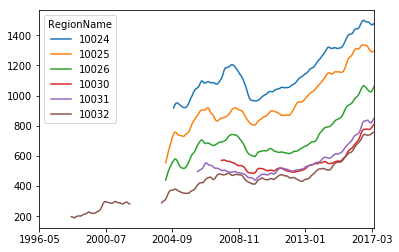

In [36]:
campus_zips_trans.plot(kind='line')

### Line plot of the rest of Manhattan

#### Manhattan polygon

In [37]:
manhattan_bounds = [
            [-74.0142059326,40.6926135281],[-74.0279388428,40.6983401818],[-74.0183258057,40.7482973548],[-73.9345550537,40.8813331133],[-73.9294052124,40.8810735379],[-73.9225387573,40.8776989647],[-73.9167022705,40.8766605999],[-73.9081192017,40.8745838214],[-73.9091491699,40.8714685315],[-73.913269043,40.865237512],[-73.9287185669,40.8455020821],[-73.9338684082,40.8299173268],[-73.9321517944,40.8075727883],[-73.9245986938,40.8000363051],[-73.9386749268,40.7818412681],[-73.9414215088,40.7711818598],[-73.9657974243,40.744395801],[-73.9661407471,40.7316491302],[-73.9716339111,40.714216056],[-73.9805603027,40.7082305151],[-73.9987564087,40.7048471453],[-74.0142059326,40.6926135281]
        ]

manhattan_box = Polygon(manhattan_bounds)
manhattan_zips = zillow_newyork_zips[zillow_newyork_zips.intersects(manhattan_box)]

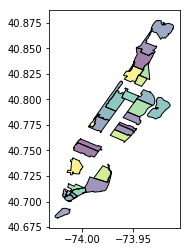

In [38]:
manhattan_zips.plot()

In [39]:
manhattan_zips.set_index('RegionName', inplace=True)
manhattan_zips

,RegionID,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,1999-01,1999-02,1999-03,1999-04,1999-05,1999-06,1999-07,1999-08,1999-09,1999-10,1999-11,1999-12,2000-01,2000-02,2000-03,2000-04,2000-05,2000-06,2000-07,2000-08,2000-09,2000-10,2000-11,2000-12,2001-01,2001-02,2001-03,2001-04,2001-05,2001-06,2001-07,2001-08,2001-09,2001-10,2001-11,2001-12,2002-01,2002-02,2002-03,2002-04,2002-05,2002-06,2002-07,2002-08,2002-09,2002-10,2002-11,2002-12,2003-01,2003-02,2003-03,2003-04,2003-05,2003-06,2003-07,2003-08,2003-09,2003-10,2003-11,2003-12,2004-01,2004-02,2004-03,2004-04,2004-05,2004-06,2004-07,2004-08,2004-09,2004-10,2004-11,2004-12,2005-01,2005-02,2005-03,2005-04,2005-05,2005-06,2005-07,2005-08,2005-09,2005-10,2005-11,2005-12,2006-01,2006-02,...,2008-02,2008-03,2008-04,2008-05,2008-06,2008-07,2008-08,2008-09,2008-10,2008-11,2008-12,2009-01,2009-02,2009-03,2009-04,2009-05,2009-06,2009-07,2009-08,2009-09,2009-10,2009-11,2009-12,2010-01,2010-02,2010-03,2010-04,2010-05,2010-06,2010-07,2010-08,2010-09,2010-10,2010-11,2010-12,2011-01,2011-02,2011-03,2011-04,2011-05,2011-06,2011-07,2011-08,2011-09,2011-10,2011-11,2011-12,2012-01,2012-02,2012-03,2012-04,2012-05,2012-06,2012-07,2012-08,2012-09,2012-10,2012-11,2012-12,2013-01,2013-02,2013-03,2013-04,2013-05,2013-06,2013-07,2013-08,2013-09,2013-10,2013-11,2013-12,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,AREA,BLDGZIP,COUNTY,CTY_FIPS,POPULATION,PO_NAME,SHAPE_AREA,SHAPE_LEN,STATE,ST_FIPS,URL,ZIPCODE,geometry
RegionName,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
10001,61615,New York,NY,New York,New York,2148,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,641.0,679.0,720.0,758.0,792.0,824.0,849.0,865.0,882.0,889.0,886.0,882.0,891.0,899.0,906.0,916.0,931.0,945.0,968.0,999.0,1031.0,1053.0,1068.0,1078.0,...,1222.0,1231.0,1235.0,1234.0,1230.0,1226.0,1225.0,1226.0,1225.0,1219.0,1208.0,1198.0,1192.0,1183.0,1163.0,1141.0,1119.0,1097.0,1081.0,1072.0,1065.0,1057.0,1045.0,1032.0,1027.0,1034.0,1043.0,1056.0,1069.0,1079.0,1083.0,1084.0,1082.0,1084.0,1090.0,1093.0,1090.0,1087.0,1087.0,1091.0,1093.0,1096.0,1104.0,1116.0,1128.0,1137.0,1144.0,1148.0,1149.0,1151.0,1159.0,1167.0,1176.0,1187.0,1197.0,1203.0,1209.0,1215.0,1226.0,1240.0,1259.0,1284.0,1307.0,1321.0,1336.0,1352.0,1370,1392,1414,1436,1465,1500,1522,1531,1540,1548,1547,1540,1534,1535,1542,1552,1553,1551,1551,1553,1561,1583,1613,1643,1663,1673,1674,1672,1669,1673,1686.0,1696.0,1695.0,1696.0,1703,1710,1718,1719,1716,1720,1716.0,1705,1697,1693,1687,1685,1.779494e+07,0,New York,061,22413.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10001,POLYGON ((-74.00827017706987 40.75258680959694...
10002,61616,New York,NY,New York,New York,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [40]:
manhattan_zips_trans = manhattan_zips.transpose()
manhattan_zips_trans = manhattan_zips_trans[7:260]
manhattan_zips_trans

RegionName,10001,10002,10004,10004,10005,10006,10007,10009,10014,10018,10021,10023,10024,10025,10026,10029,10030,10031,10032,10033,10034,10035,10035,10038,10039,10065,10069,10075,10128,10280
1996-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1997-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1997-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


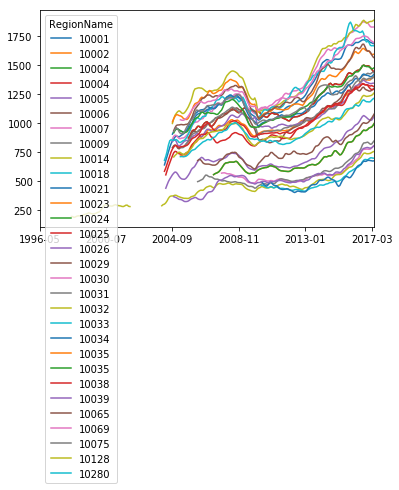

In [41]:
manhattan_zips_trans.plot(kind='line')

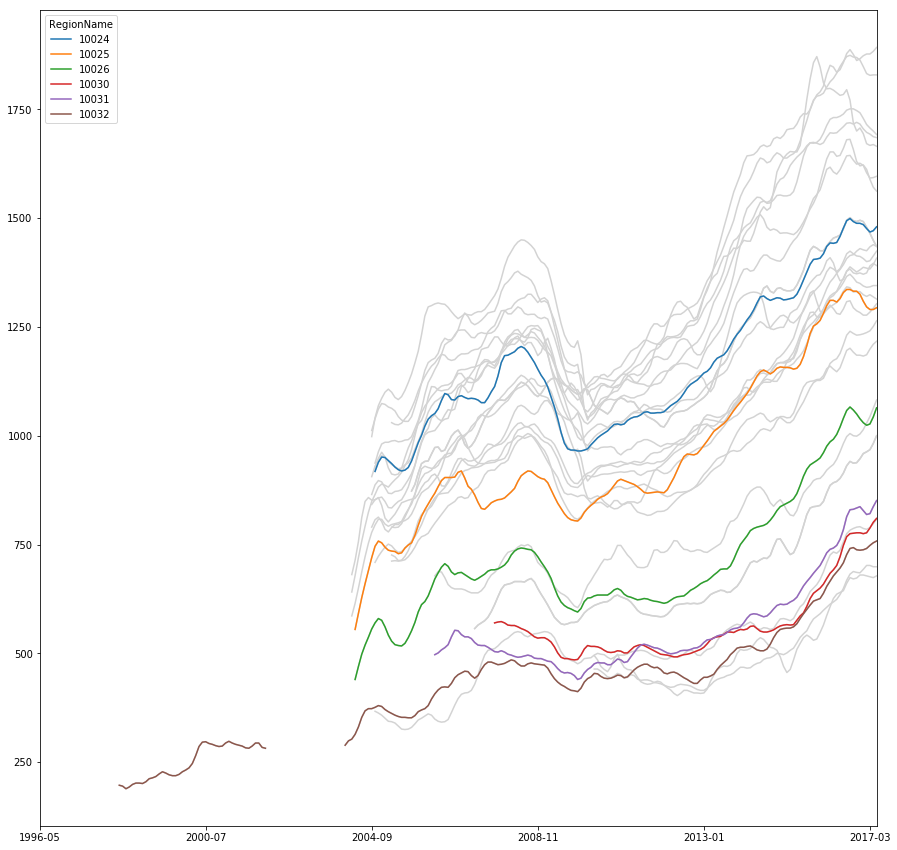

In [42]:
ax = manhattan_zips_trans.plot(kind='line', color='lightgrey', legend=False, figsize=(15,15))
campus_zips_trans.plot(kind='line', ax=ax)

plt.savefig('Campus vs. Manhattan ZIPs.pdf', bbox_inches='tight')

### Pct_change

In [43]:
campus_zips_trans

RegionName,10024,10025,10026,10030,10031,10032
1996-05,NaN,NaN,NaN,NaN,NaN,NaN
1996-06,NaN,NaN,NaN,NaN,NaN,NaN
1996-07,NaN,NaN,NaN,NaN,NaN,NaN
1996-08,NaN,NaN,NaN,NaN,NaN,NaN
1996-09,NaN,NaN,NaN,NaN,NaN,NaN
1996-10,NaN,NaN,NaN,NaN,NaN,NaN
1996-11,NaN,NaN,NaN,NaN,NaN,NaN
1996-12,NaN,NaN,NaN,NaN,NaN,NaN
1997-01,NaN,NaN,NaN,NaN,NaN,NaN
1997-02,NaN,NaN,NaN,NaN,NaN,NaN


In [44]:
campus_zips_trans.pct_change()

RegionName,10024,10025,10026,10030,10031,10032
1996-05,NaN,NaN,NaN,NaN,NaN,NaN
1996-06,NaN,NaN,NaN,NaN,NaN,NaN
1996-07,NaN,NaN,NaN,NaN,NaN,NaN
1996-08,NaN,NaN,NaN,NaN,NaN,NaN
1996-09,NaN,NaN,NaN,NaN,NaN,NaN
1996-10,NaN,NaN,NaN,NaN,NaN,NaN
1996-11,NaN,NaN,NaN,NaN,NaN,NaN
1996-12,NaN,NaN,NaN,NaN,NaN,NaN
1997-01,NaN,NaN,NaN,NaN,NaN,NaN
1997-02,NaN,NaN,NaN,NaN,NaN,NaN


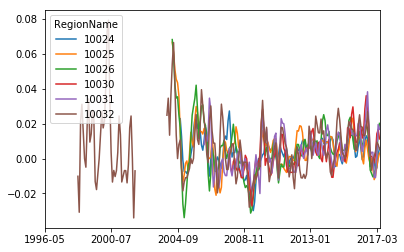

In [45]:
campus_zips_trans.pct_change().plot(kind='line')

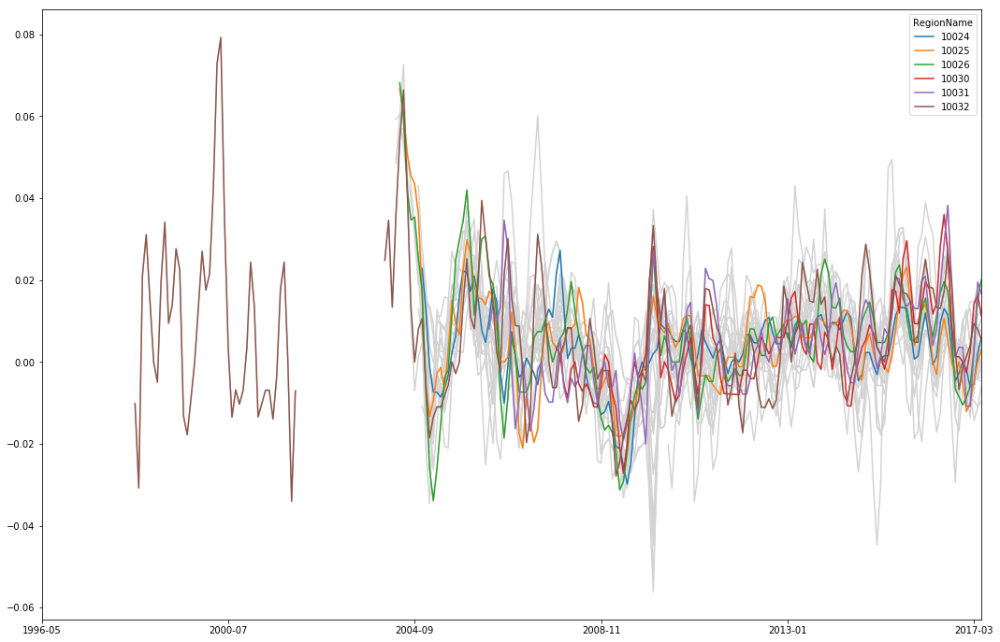

In [46]:
ax = manhattan_zips_trans.pct_change().plot(kind='line', color='lightgrey', legend=False, figsize=(18,12))
campus_zips_trans.pct_change().plot(kind='line', ax=ax)

plt.savefig('Campus vs Manhattan ZIPs pct_change.pdf', bbox_inches='tight')

### Plot with different color of circle

##### First try, reject

In [47]:
color_bins = [
    {
        'min_value':0,
        'max_value':249,
        'color': '#ffe5e5'
    },
    {
        'min_value':250,
        'max_value':499,
        'color': '#ffb2b2'
    },
    {
        'min_value':500,
        'max_value':749,
        'color': '#ff7f7f'
    },
    {
        'min_value':750,
        'max_value':999,
        'color': '#ff4c4c'
    },
    {
        'min_value':1000,
        'max_value':1249,
        'color': '#ff1919'
    },
    {
        'min_value':1250,
        'max_value':1499,
        'color': '#ff0000'
    },
    {
        'min_value':1500,
        'max_value':1749,
        'color': '#cc0000'
    },
    {
        'min_value':1750,
        'max_value':1999,
        'color': '#990000'
    },
    {
        'min_value':2000,
        'max_value':2249,
        'color': '#660000'
    }
]

<function matplotlib.pyplot.title>

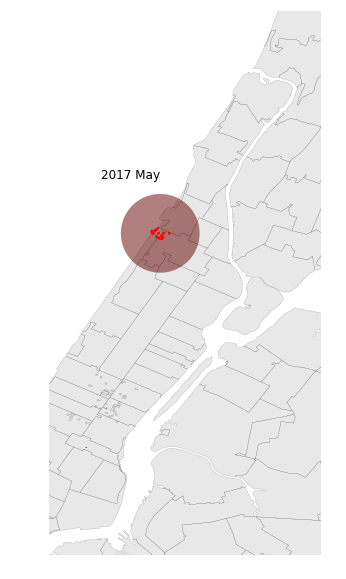

In [48]:
for element in color_bins:
    if int(campus_zips['2017-05'].mean()) >= element['min_value'] & int(campus_zips['2017-05'].mean()) <= element['max_value']:
        my_color = element['color']
    else:
        my_color = 'black'

ax = zip_codes.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.1)
campus.plot(color='red', ax=ax, edgecolor='red')
campus_buffer = campus.buffer(0.01449275362).unary_union.centroid.buffer(0.01449275362)
gpd.plotting.plot_multipolygon(ax=ax, geom=campus_buffer, facecolor=my_color, edgecolor=my_color, linewidth=0)
ax.axis([-74,-73.9,40.7,40.9])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.axis('off')
plt.title('2017 May', y=0.68, x=0.3)
plt.title

### Loop for every month
Second try, KEEP

#### List of dates

In [49]:
dates = zillow_newyork_zips.columns.tolist()
dates = dates[100:261]
dates

['2004-01',
 '2004-02',
 '2004-03',
 '2004-04',
 '2004-05',
 '2004-06',
 '2004-07',
 '2004-08',
 '2004-09',
 '2004-10',
 '2004-11',
 '2004-12',
 '2005-01',
 '2005-02',
 '2005-03',
 '2005-04',
 '2005-05',
 '2005-06',
 '2005-07',
 '2005-08',
 '2005-09',
 '2005-10',
 '2005-11',
 '2005-12',
 '2006-01',
 '2006-02',
 '2006-03',
 '2006-04',
 '2006-05',
 '2006-06',
 '2006-07',
 '2006-08',
 '2006-09',
 '2006-10',
 '2006-11',
 '2006-12',
 '2007-01',
 '2007-02',
 '2007-03',
 '2007-04',
 '2007-05',
 '2007-06',
 '2007-07',
 '2007-08',
 '2007-09',
 '2007-10',
 '2007-11',
 '2007-12',
 '2008-01',
 '2008-02',
 '2008-03',
 '2008-04',
 '2008-05',
 '2008-06',
 '2008-07',
 '2008-08',
 '2008-09',
 '2008-10',
 '2008-11',
 '2008-12',
 '2009-01',
 '2009-02',
 '2009-03',
 '2009-04',
 '2009-05',
 '2009-06',
 '2009-07',
 '2009-08',
 '2009-09',
 '2009-10',
 '2009-11',
 '2009-12',
 '2010-01',
 '2010-02',
 '2010-03',
 '2010-04',
 '2010-05',
 '2010-06',
 '2010-07',
 '2010-08',
 '2010-09',
 '2010-10',
 '2010-11',
 '20

#### Loop

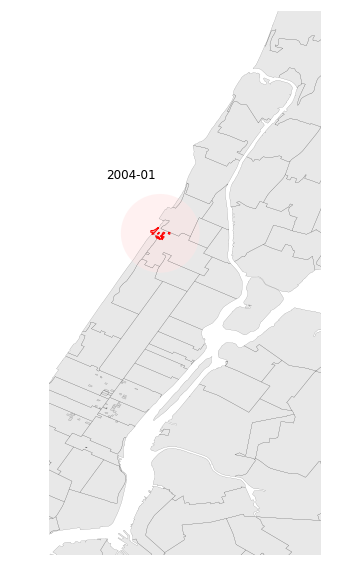

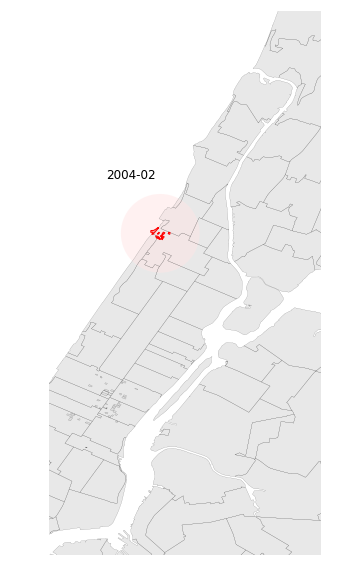

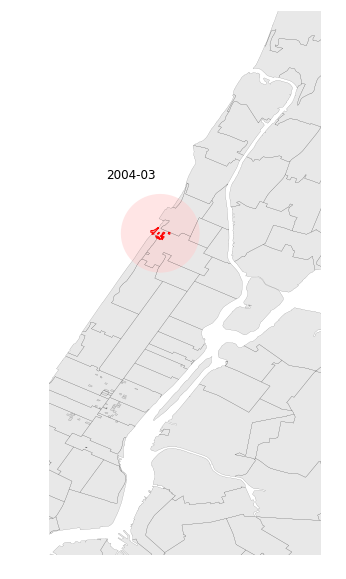

In [52]:
for one_date in dates[:3]:

    color_bins = {
        range(0,300):'#ffe5e5',
        range(300,400):'#ffcccc',
        range(400,500):'#ffb2b2',
        range(500,600):'#ff9999',
        range(600,700):'#ff7f7f',
        range(700,800):'#ff6666',
        range(800,900):'#ff4c4c',
        range(900,1000):'#ff3232',
        range(1000,1100):'#ff1919',
        range(1100,1200):'#ff0000',
        range(1200,1300):'#e50000',
        range(1300,1400):'#cc0000',
        range(1400,1500):'#b20000',
        range(1500,1600):'#990000',
        range(1600,1700):'#7f0000',
        range(1700,1800):'#660000',
        range(1800,1900):'#4c0000',
        range(1900,2000):'#330000',
        range(2000,2100):'#190000',
        range(2100,2200):'',
    }
    
    for value, color in color_bins.items():
        if int(campus_zips[one_date].mean()) in value:
            my_color = color
            break
        else:
            my_color = 'black'

    ax = zip_codes.plot(figsize=(10,10), color='lightgrey', edgecolor='black', linewidth=0.1)
    campus.plot(color='red', ax=ax, edgecolor='red')
    campus_buffer = campus.buffer(0.01449275362).unary_union.centroid.buffer(0.01449275362)
    gpd.plotting.plot_multipolygon(ax=ax, geom=campus_buffer, facecolor=my_color, edgecolor=my_color, linewidth=0)
    ax.axis([-74,-73.9,40.7,40.9])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.axis('off')
    plt.title(one_date, y=0.68, x=0.3)
    
    plt.savefig(one_date + '.png')

### Better Styling

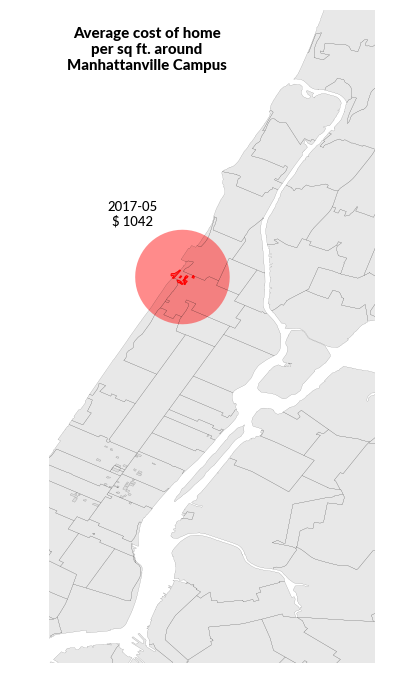

In [127]:
color_bins = {
        range(0,300):'#ffe5e5',
        range(300,400):'#ffcccc',
        range(400,500):'#ffb2b2',
        range(500,600):'#ff9999',
        range(600,700):'#ff7f7f',
        range(700,800):'#ff6666',
        range(800,900):'#ff4c4c',
        range(900,1000):'#ff3232',
        range(1000,1100):'#ff1919',
        range(1100,1200):'#ff0000',
        range(1200,1300):'#e50000',
        range(1300,1400):'#cc0000',
        range(1400,1500):'#b20000',
        range(1500,1600):'#990000',
        range(1600,1700):'#7f0000',
        range(1700,1800):'#660000',
        range(1800,1900):'#4c0000',
        range(1900,2000):'#330000',
        range(2000,2100):'#190000',
        range(2100,2200):'',
    }
    
for value, color in color_bins.items():
    if int(campus_zips['2017-05'].mean()) in value:
        my_color = color
        break
    else:
        my_color = 'black'

ax = zip_codes.plot(figsize=(12,12), color='lightgrey', edgecolor='black', linewidth=0.1)
campus.plot(color='red', ax=ax, edgecolor='red')
campus_buffer = campus.buffer(0.01449275362).unary_union.centroid.buffer(0.01449275362)
gpd.plotting.plot_multipolygon(ax=ax, geom=campus_buffer, facecolor=my_color, edgecolor=my_color, linewidth=0)
ax.axis([-74,-73.9,40.7,40.9])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.axis('off')
plt.suptitle(t = '2017-05\n' + '$ ' + str(int(campus_zips['2017-05'].mean())), y=0.66, x=0.42, fontname='Lato', fontsize=13, fontweight='medium')
plt.title(s = 'Average cost of home\nper sq ft. around\nManhattanville Campus', y=0.9, x=0.3, fontdict={'fontsize': 15,
        'fontname': 'Lato', 'fontweight':'heavy'})

##### Loop

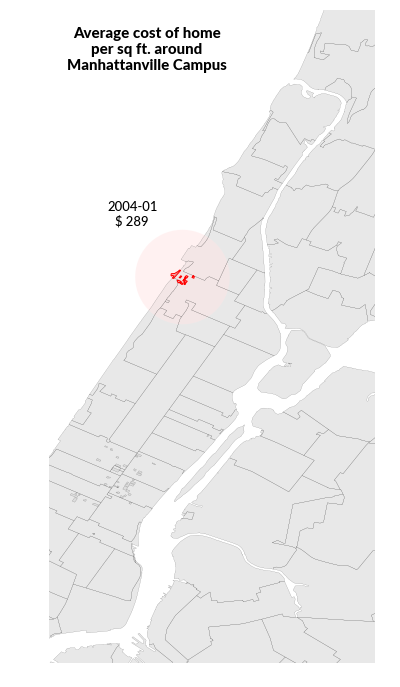

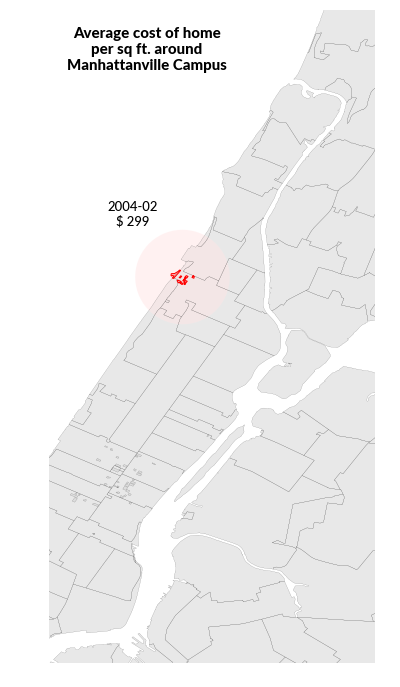

In [129]:
for one_date in dates[:2]:
    color_bins = {
            range(0,300):'#ffe5e5',
            range(300,400):'#ffcccc',
            range(400,500):'#ffb2b2',
            range(500,600):'#ff9999',
            range(600,700):'#ff7f7f',
            range(700,800):'#ff6666',
            range(800,900):'#ff4c4c',
            range(900,1000):'#ff3232',
            range(1000,1100):'#ff1919',
            range(1100,1200):'#ff0000',
            range(1200,1300):'#e50000',
            range(1300,1400):'#cc0000',
            range(1400,1500):'#b20000',
            range(1500,1600):'#990000',
            range(1600,1700):'#7f0000',
            range(1700,1800):'#660000',
            range(1800,1900):'#4c0000',
            range(1900,2000):'#330000',
            range(2000,2100):'#190000',
            range(2100,2200):'',
        }

    for value, color in color_bins.items():
        if int(campus_zips[one_date].mean()) in value:
            my_color = color
            break
        else:
            my_color = 'black'

    ax = zip_codes.plot(figsize=(12,12), color='lightgrey', edgecolor='black', linewidth=0.1)
    campus.plot(color='red', ax=ax, edgecolor='red')
    campus_buffer = campus.buffer(0.01449275362).unary_union.centroid.buffer(0.01449275362)
    gpd.plotting.plot_multipolygon(ax=ax, geom=campus_buffer, facecolor=my_color, edgecolor=my_color, linewidth=0)
    ax.axis([-74,-73.9,40.7,40.9])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.axis('off')
    plt.suptitle(t =  one_date + '\n' + '$ ' + str(int(campus_zips[one_date].mean())), y=0.66, x=0.42, fontname='Lato', fontsize=13, fontweight='medium')
    plt.title(s = 'Average cost of home\nper sq ft. around\nManhattanville Campus', y=0.9, x=0.3, fontdict={'fontsize': 15,
            'fontname': 'Lato', 'fontweight':'heavy'})

### Change date format

In [50]:
campus_zips.columns

Index(['RegionID', 'City', 'State', 'Metro', 'CountyName', 'SizeRank',
       '1996-04', '1996-05', '1996-06', '1996-07',
       ...
       'CTY_FIPS', 'POPULATION', 'PO_NAME', 'SHAPE_AREA', 'SHAPE_LEN', 'STATE',
       'ST_FIPS', 'URL', 'ZIPCODE', 'geometry'],
      dtype='object', length=273)

In [51]:
months = pd.to_datetime(campus_zips.columns[6:260]).strftime(date_format='%B %Y').tolist()
months = months[93:]
months

['January 2004',
 'February 2004',
 'March 2004',
 'April 2004',
 'May 2004',
 'June 2004',
 'July 2004',
 'August 2004',
 'September 2004',
 'October 2004',
 'November 2004',
 'December 2004',
 'January 2005',
 'February 2005',
 'March 2005',
 'April 2005',
 'May 2005',
 'June 2005',
 'July 2005',
 'August 2005',
 'September 2005',
 'October 2005',
 'November 2005',
 'December 2005',
 'January 2006',
 'February 2006',
 'March 2006',
 'April 2006',
 'May 2006',
 'June 2006',
 'July 2006',
 'August 2006',
 'September 2006',
 'October 2006',
 'November 2006',
 'December 2006',
 'January 2007',
 'February 2007',
 'March 2007',
 'April 2007',
 'May 2007',
 'June 2007',
 'July 2007',
 'August 2007',
 'September 2007',
 'October 2007',
 'November 2007',
 'December 2007',
 'January 2008',
 'February 2008',
 'March 2008',
 'April 2008',
 'May 2008',
 'June 2008',
 'July 2008',
 'August 2008',
 'September 2008',
 'October 2008',
 'November 2008',
 'December 2008',
 'January 2009',
 'February 20

#### and now the loop

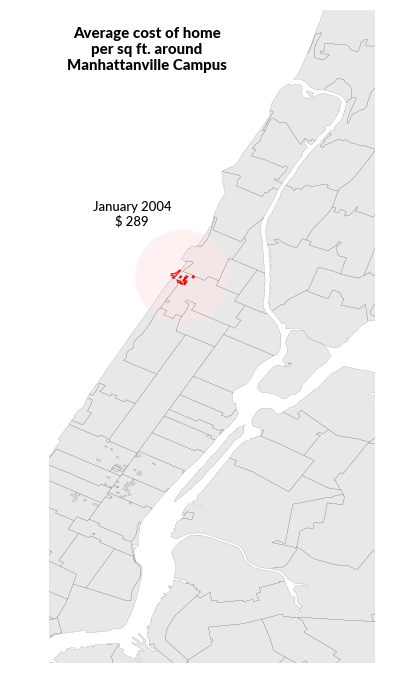

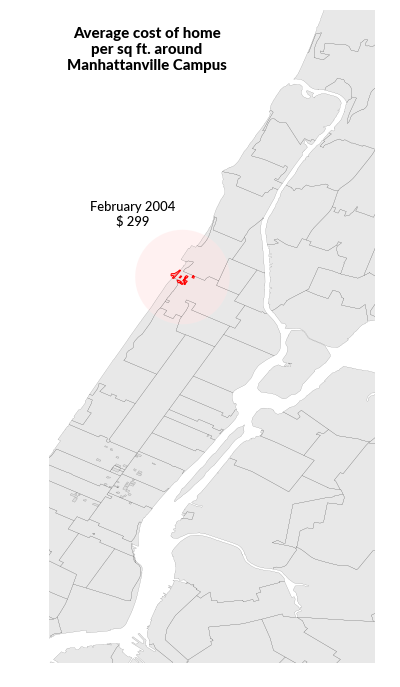

In [156]:
for one_date,one_month in zip(dates[:2],months[:2]):
    color_bins = {
            range(0,300):'#ffe5e5',
            range(300,400):'#ffcccc',
            range(400,500):'#ffb2b2',
            range(500,600):'#ff9999',
            range(600,700):'#ff7f7f',
            range(700,800):'#ff6666',
            range(800,900):'#ff4c4c',
            range(900,1000):'#ff3232',
            range(1000,1100):'#ff1919',
            range(1100,1200):'#ff0000',
            range(1200,1300):'#e50000',
            range(1300,1400):'#cc0000',
            range(1400,1500):'#b20000',
            range(1500,1600):'#990000',
            range(1600,1700):'#7f0000',
            range(1700,1800):'#660000',
            range(1800,1900):'#4c0000',
            range(1900,2000):'#330000',
            range(2000,2100):'#190000',
            range(2100,2200):'',
        }

    for value, color in color_bins.items():
        if int(campus_zips[one_date].mean()) in value:
            my_color = color
            break
        else:
            my_color = 'black'

    ax = zip_codes.plot(figsize=(12,12), color='lightgrey', edgecolor='black', linewidth=0.1)
    campus.plot(color='red', ax=ax, edgecolor='red')
    campus_buffer = campus.buffer(0.01449275362).unary_union.centroid.buffer(0.01449275362)
    gpd.plotting.plot_multipolygon(ax=ax, geom=campus_buffer, facecolor=my_color, edgecolor=my_color, linewidth=0)
    ax.axis([-74,-73.9,40.7,40.9])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.axis('off')
    plt.suptitle(t = one_month + '\n' + '$ ' + str(int(campus_zips[one_date].mean())), y=0.66, x=0.42, fontname='Lato', fontsize=13, fontweight='medium')
    plt.title(s = 'Average cost of home\nper sq ft. around\nManhattanville Campus', y=0.9, x=0.3, fontdict={'fontsize': 15,
            'fontname': 'Lato', 'fontweight':'heavy'})
    
    

### PRINT EVERYTHING

/usr/local/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


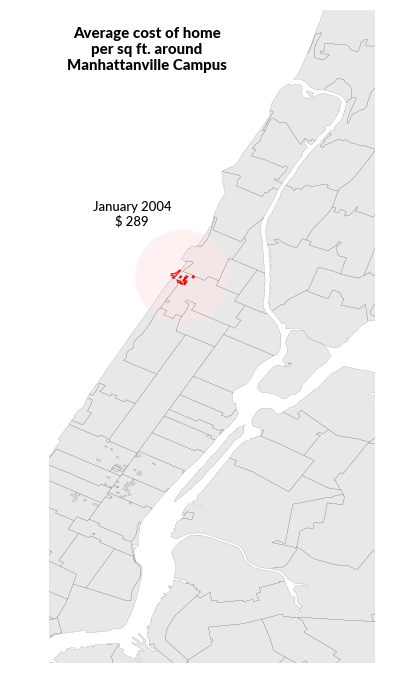

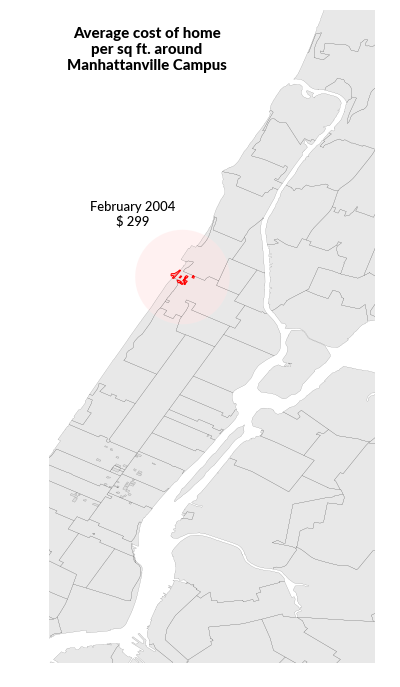

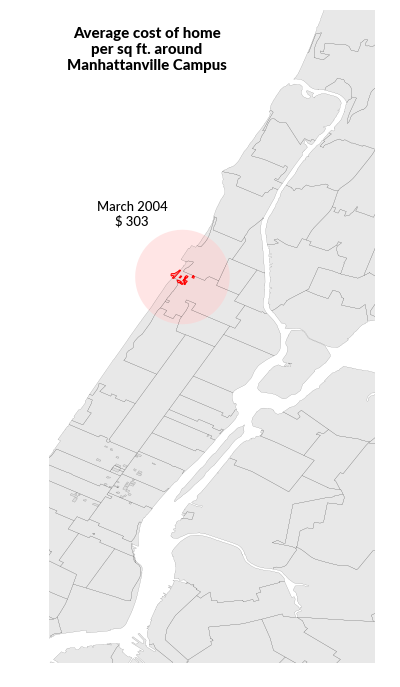

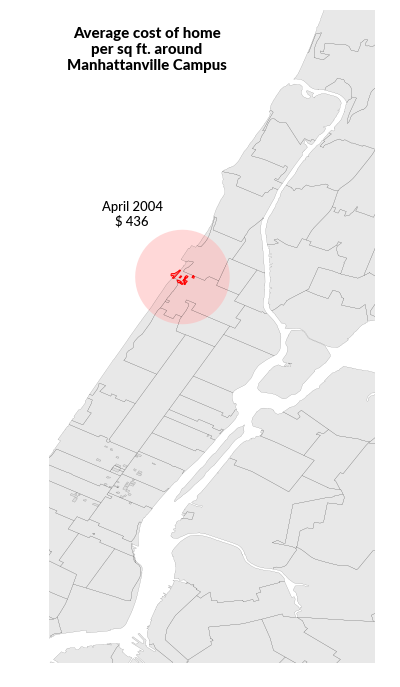

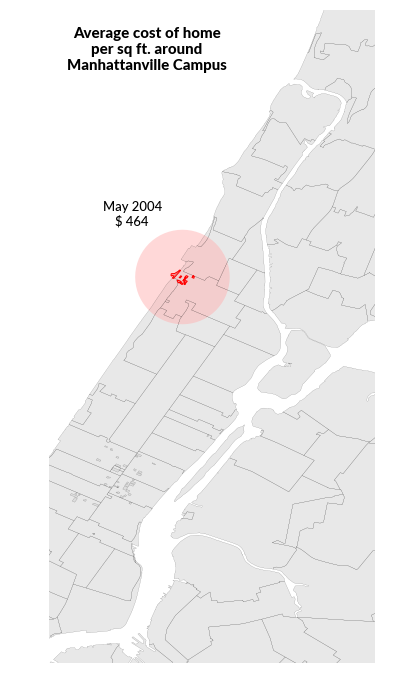

...

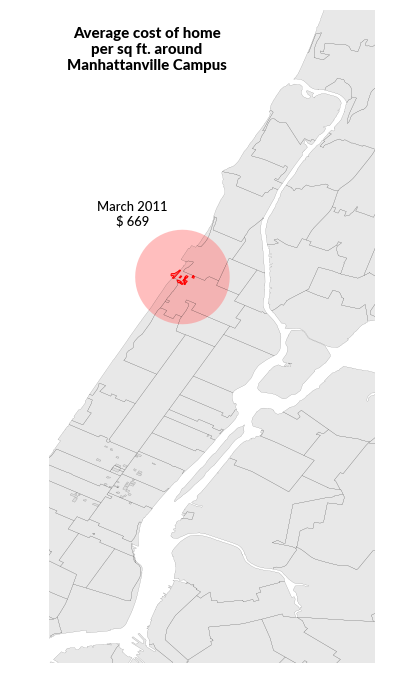

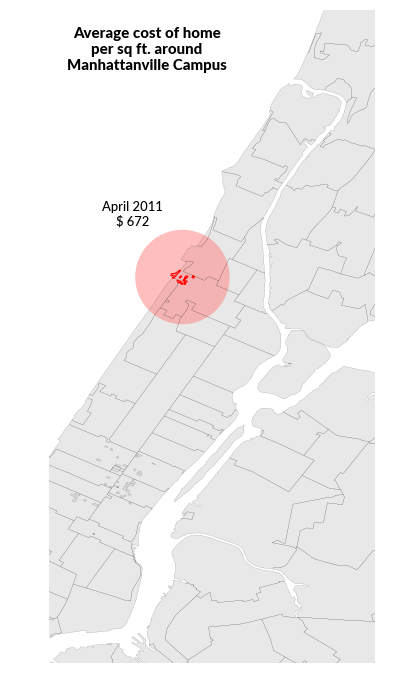

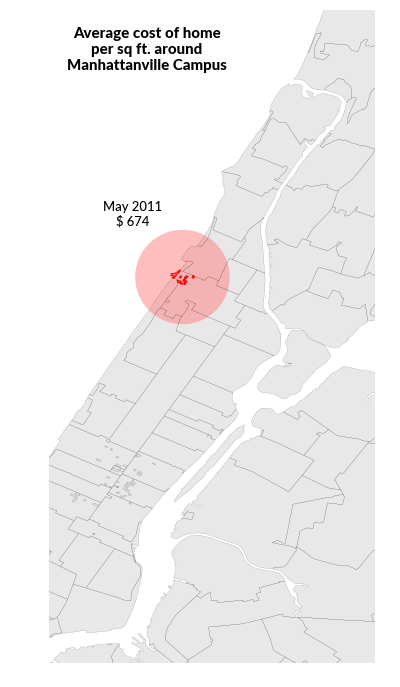

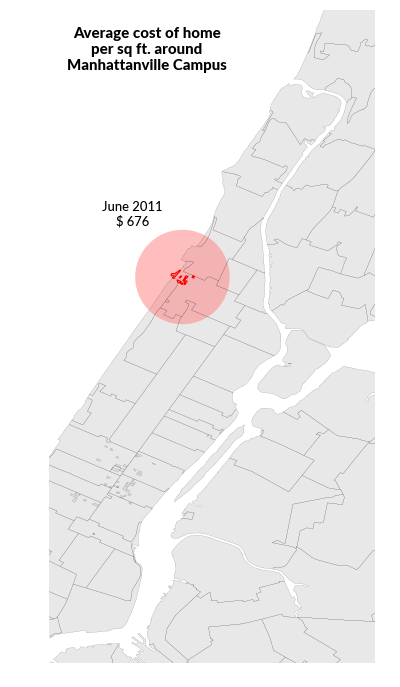

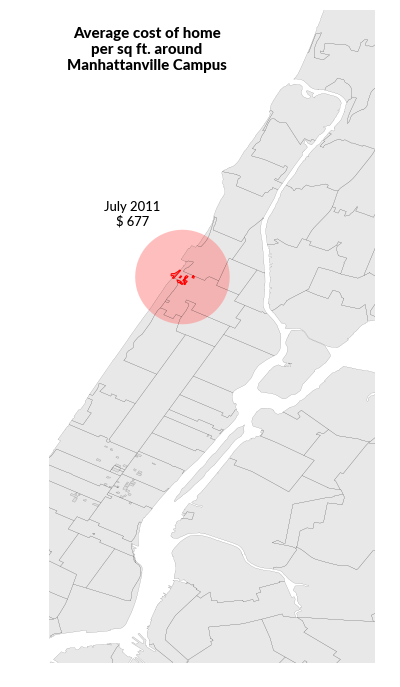

In [ ]:
for one_date,one_month in zip(dates,months):
    color_bins = {
            range(0,300):'#ffe5e5',
            range(300,400):'#ffcccc',
            range(400,500):'#ffb2b2',
            range(500,600):'#ff9999',
            range(600,700):'#ff7f7f',
            range(700,800):'#ff6666',
            range(800,900):'#ff4c4c',
            range(900,1000):'#ff3232',
            range(1000,1100):'#ff1919',
            range(1100,1200):'#ff0000',
            range(1200,1300):'#e50000',
            range(1300,1400):'#cc0000',
            range(1400,1500):'#b20000',
            range(1500,1600):'#990000',
            range(1600,1700):'#7f0000',
            range(1700,1800):'#660000',
            range(1800,1900):'#4c0000',
            range(1900,2000):'#330000',
            range(2000,2100):'#190000',
            range(2100,2200):'',
        }

    for value, color in color_bins.items():
        if int(campus_zips[one_date].mean()) in value:
            my_color = color
            break
        else:
            my_color = 'black'

    ax = zip_codes.plot(figsize=(12,12), color='lightgrey', edgecolor='black', linewidth=0.1)
    campus.plot(color='red', ax=ax, edgecolor='red')
    campus_buffer = campus.buffer(0.01449275362).unary_union.centroid.buffer(0.01449275362)
    gpd.plotting.plot_multipolygon(ax=ax, geom=campus_buffer, facecolor=my_color, edgecolor=my_color, linewidth=0)
    ax.axis([-74,-73.9,40.7,40.9])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.axis('off')
    plt.suptitle(t = one_month + '\n' + '$ ' + str(int(campus_zips[one_date].mean())), y=0.66, x=0.42, fontname='Lato', fontsize=13, fontweight='medium')
    plt.title(s = 'Average cost of home\nper sq ft. around\nManhattanville Campus', y=0.9, x=0.3, fontdict={'fontsize': 15,
            'fontname': 'Lato', 'fontweight':'heavy'})
    
    plt.savefig(one_date + '.pdf', bbox_inches='tight')

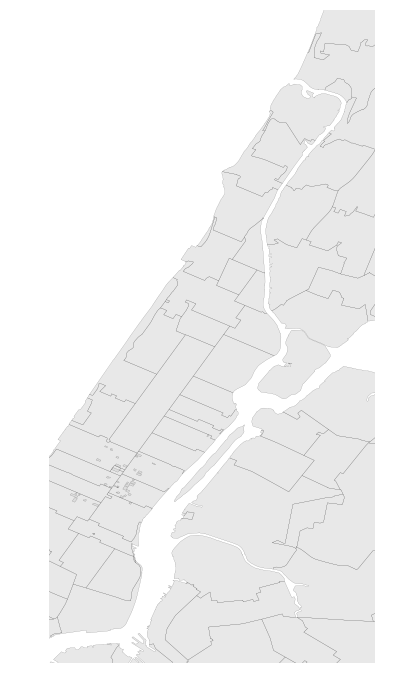

In [164]:
ax = zip_codes.plot(figsize=(12,12), color='lightgrey', edgecolor='black', linewidth=0.1)
ax.axis([-74,-73.9,40.7,40.9])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.axis('off')

plt.savefig('2004-00.png', bbox_inches='tight')

### Rest of Manhattan

In [171]:
manhattan_all_zips = zip_codes[zip_codes.within(manhattan_box)]
manhattan_all_zips

,AREA,BLDGZIP,COUNTY,CTY_FIPS,POPULATION,PO_NAME,SHAPE_AREA,SHAPE_LEN,STATE,ST_FIPS,URL,ZIPCODE,geometry
54,3.830099e+07,0,New York,061,25.0,Central Park,0.0,0.0,NY,36,http://www.usps.com/,00083,POLYGON ((-73.94922045723267 40.79690954939698...
82,1.779494e+07,0,New York,061,22413.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10001,POLYGON ((-74.00827017706987 40.75258680959694...
92,2.628013e+07,0,New York,061,81305.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10002,POLYGON ((-73.97441674502171 40.73642408546696...
90,1.553838e+07,0,New York,061,55878.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10003,POLYGON ((-73.97986374206835 40.73497413255047...
106,4.002521e+06,0,New York,061,2187.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10004,POLYGON ((-74.01101005119982 40.70621840523224...
104,2.082901e+06,0,New York,061,8107.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10005,POLYGON ((-74.00596661457033 40.70432398933988...
102,1.716641e+06,0,New York,061,3011.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10006,POLYGON ((-74.01123100039382 40.71036655056447...
97,5.327871e+06,0,New York,061,7323.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10007,"POLYGON ((-74.0133873791513 40.71743717586853,..."
94,1.590352e+07,0,New York,061,61455.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10009,POLYGON ((-73.97345725849812 40.73070754108713...
87,9.768396e+06,0,New York,061,29881.0,New York,0.0,0.0,NY,36,http://www.usps.com/,10010,POLYGON ((-73.98827138035786 40.74347939182169...


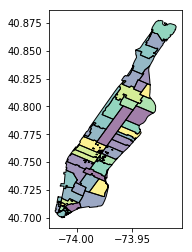

In [172]:
manhattan_all_zips.plot()

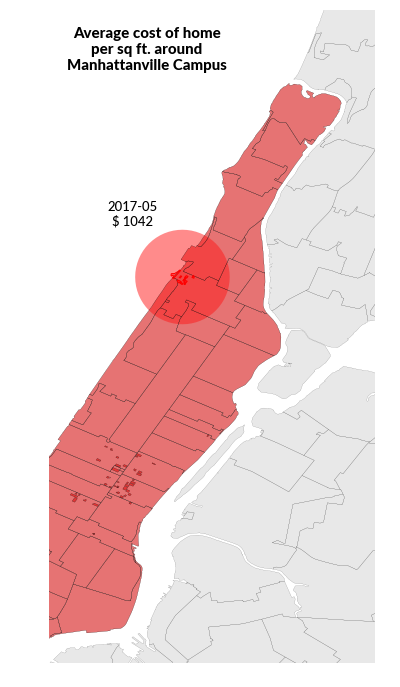

In [199]:
color_bins = {
        range(0,300):'#ffe5e5',
        range(300,400):'#ffcccc',
        range(400,500):'#ffb2b2',
        range(500,600):'#ff9999',
        range(600,700):'#ff7f7f',
        range(700,800):'#ff6666',
        range(800,900):'#ff4c4c',
        range(900,1000):'#ff3232',
        range(1000,1100):'#ff1919',
        range(1100,1200):'#ff0000',
        range(1200,1300):'#e50000',
        range(1300,1400):'#cc0000',
        range(1400,1500):'#b20000',
        range(1500,1600):'#990000',
        range(1600,1700):'#7f0000',
        range(1700,1800):'#660000',
        range(1800,1900):'#4c0000',
        range(1900,2000):'#330000',
        range(2000,2100):'#190000',
        range(2100,2200):'',
    }
    
for value, color in color_bins.items():
    if int(campus_zips['2017-05'].mean()) in value:
        my_color = color
        break
    else:
        my_color = 'black'

for value, color in color_bins.items():
    if int(manhattan_zips['2017-04'].mean()) in value:
        manh_color = color
        break
    else:
        manh_color = 'pink'

ax = zip_codes.plot(figsize=(12,12), color='lightgrey', edgecolor='black', linewidth=0.1)
manhattan_all_zips.plot(ax=ax, color=manh_color, edgecolor='black', linewidth=0.1)
campus.plot(color='red', ax=ax, edgecolor='red')
campus_buffer = campus.buffer(0.01449275362).unary_union.centroid.buffer(0.01449275362)
gpd.plotting.plot_multipolygon(ax=ax, geom=campus_buffer, facecolor=my_color, edgecolor=my_color, linewidth=0)
ax.axis([-74,-73.9,40.7,40.9])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.axis('off')
plt.suptitle(t = '2017-05\n' + '$ ' + str(int(campus_zips['2017-05'].mean())), y=0.66, x=0.42, fontname='Lato', fontsize=13, fontweight='medium')
plt.title(s = 'Average cost of home\nper sq ft. around\nManhattanville Campus', y=0.9, x=0.3, fontdict={'fontsize': 15,
        'fontname': 'Lato', 'fontweight':'heavy'})

/usr/local/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


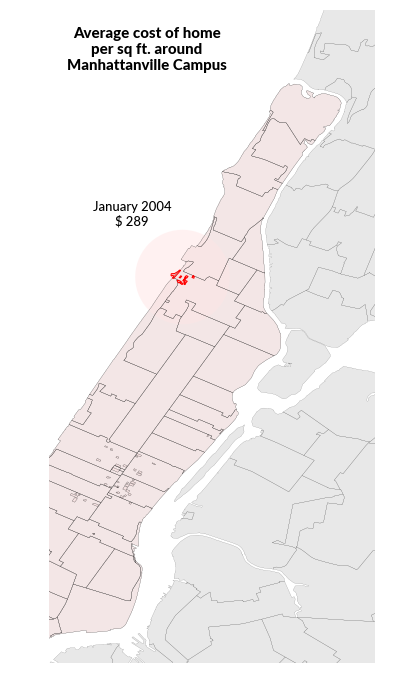

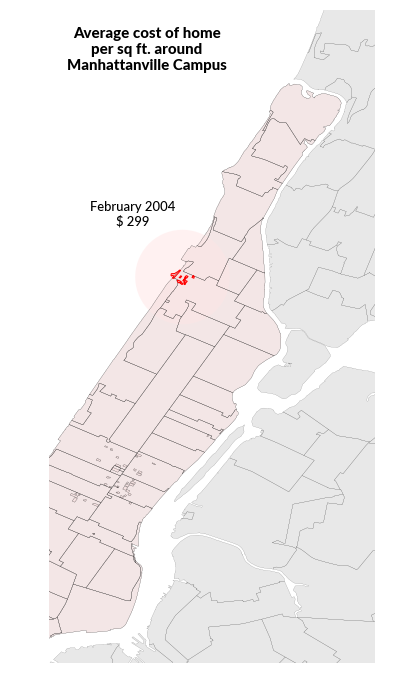

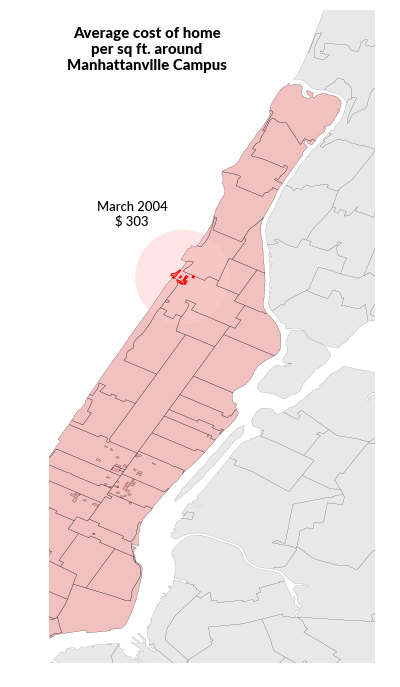

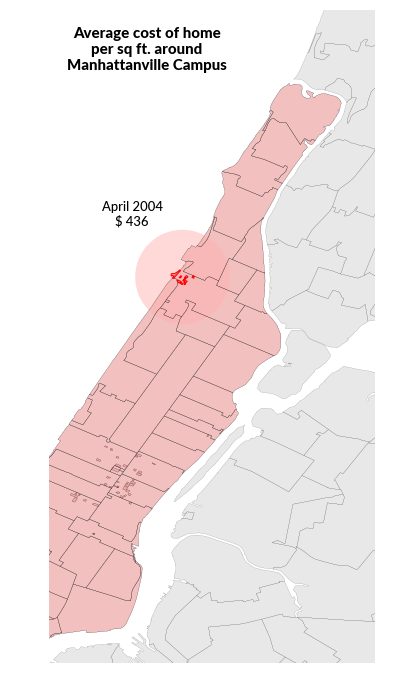

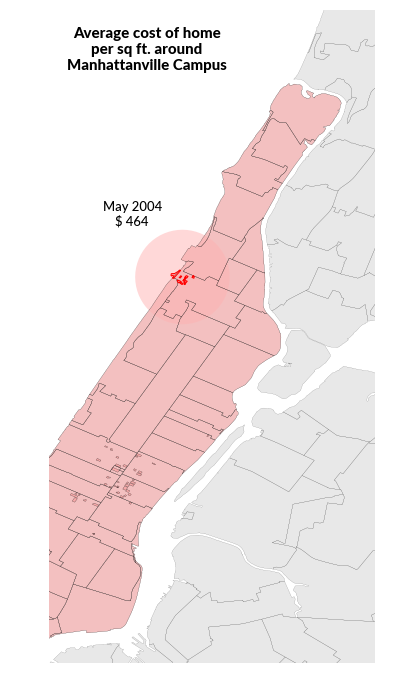

...

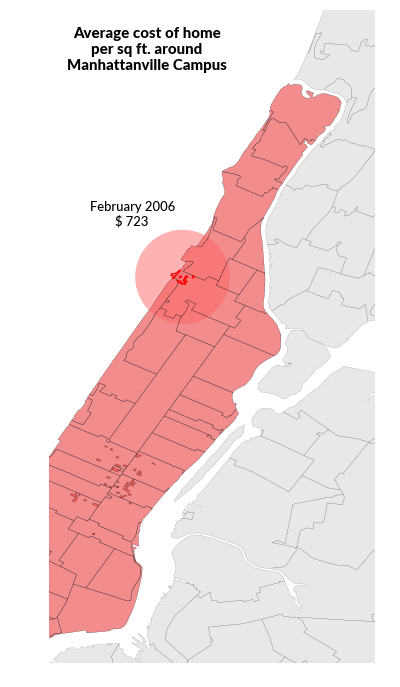

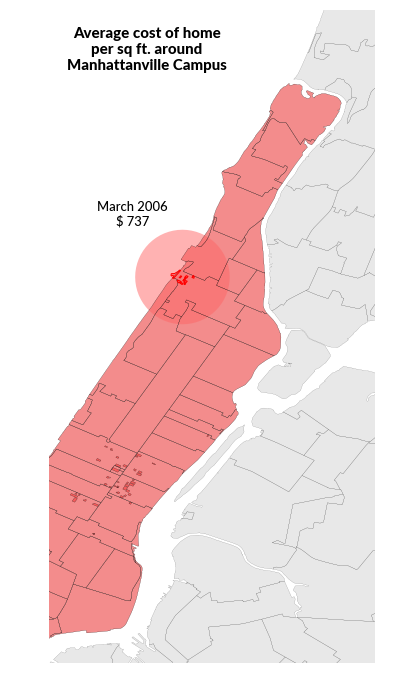

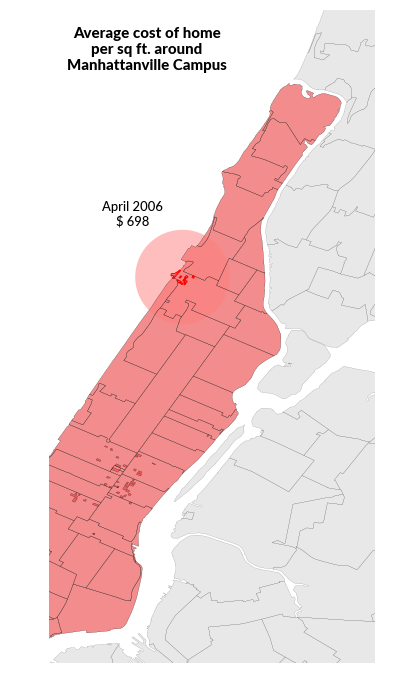

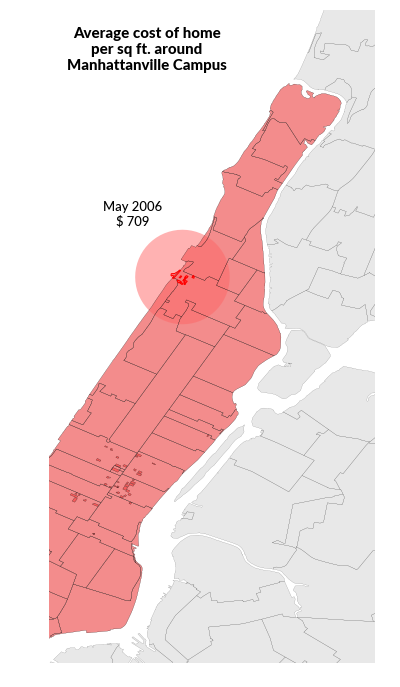

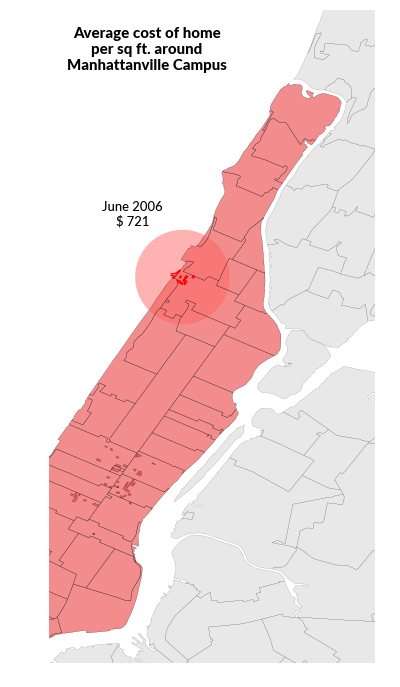

In [201]:
for one_date,one_month in zip(dates[:30],months[:30]):
    color_bins = {
            range(0,300):'#ffe5e5',
            range(300,400):'#ffcccc',
            range(400,500):'#ffb2b2',
            range(500,600):'#ff9999',
            range(600,700):'#ff7f7f',
            range(700,800):'#ff6666',
            range(800,900):'#ff4c4c',
            range(900,1000):'#ff3232',
            range(1000,1100):'#ff1919',
            range(1100,1200):'#ff0000',
            range(1200,1300):'#e50000',
            range(1300,1400):'#cc0000',
            range(1400,1500):'#b20000',
            range(1500,1600):'#990000',
            range(1600,1700):'#7f0000',
            range(1700,1800):'#660000',
            range(1800,1900):'#4c0000',
            range(1900,2000):'#330000',
            range(2000,2100):'#190000',
            range(2100,2200):'',
        }

    for value, color in color_bins.items():
        if int(campus_zips[one_date].mean()) in value:
            my_color = color
            break
        else:
            my_color = 'black'

    for value, color in color_bins.items():
        if int(manhattan_zips[one_date].mean()) in value:
            manh_color = color
            break
        else:
            manh_color = 'pink'

    ax = zip_codes.plot(figsize=(12,12), color='lightgrey', edgecolor='black', linewidth=0.1)
    manhattan_all_zips.plot(ax=ax, color=manh_color, edgecolor='black', linewidth=0.1)
    campus.plot(color='red', ax=ax, edgecolor='red')
    campus_buffer = campus.buffer(0.01449275362).unary_union.centroid.buffer(0.01449275362)
    gpd.plotting.plot_multipolygon(ax=ax, geom=campus_buffer, facecolor=my_color, edgecolor=my_color, linewidth=0)
    ax.axis([-74,-73.9,40.7,40.9])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.axis('off')
    plt.suptitle(t = one_month + '\n' + '$ ' + str(int(campus_zips[one_date].mean())), y=0.66, x=0.42, fontname='Lato', fontsize=13, fontweight='medium')
    plt.title(s = 'Average cost of home\nper sq ft. around\nManhattanville Campus', y=0.9, x=0.3, fontdict={'fontsize': 15,
            'fontname': 'Lato', 'fontweight':'heavy'})
    
    plt.savefig(one_date + '.png', bbox_inches='tight')